In [1]:
import findspark
findspark.init('/usr/hdp/current/spark2-client')

import pyspark
from pyspark.sql.functions import lit, col, instr, expr, pow, round, bround, corr, count, mean, stddev_pop, min, max
from pyspark.sql.functions import monotonically_increasing_id, initcap, lower, upper, ltrim, rtrim, rpad, lpad, trim
from pyspark.sql.functions import regexp_replace, translate, regexp_extract, current_date, current_timestamp, struct
from pyspark.sql.functions import date_add, date_sub, datediff, months_between, to_date, to_timestamp, coalesce, split, size
from pyspark.sql.functions import array_contains, explode, udf
from pyspark.sql import HiveContext
from pyspark.sql import SparkSession
from pyspark.sql.types import *
from pyspark.sql.functions import col, when

from pyspark.sql.types import StructField, StructType, StringType, IntegerType, DoubleType, FloatType, LongType

In [2]:
from sys import path
path.insert(0, '/home/prod/git/common/collect_raw_data_utils')
from data_collection import *
path.insert(0, '/home/prod/git/common/pyspark_utils')
from get_spark import get_spark

In [139]:
spark.stop()

In [4]:
SPARK_CONFIG_LIST = [
    ('spark.app.name', 'abnormal_detection'),           # spark job name
    ('spark.yarn.queue', 'prod'),                          # for production code, use 'prod', else use 'dev'
    ('spark.master', 'yarn'),                              # choose between 'yarn', 'local', or 'local[*]'
    ('spark.submit.deployMode', 'client'),                 # 'client' or 'cluster' mode
    ('spark.yarn.am.memory', '20g'),                       # memory for spark driver (application master), for client mode
    ('spark.executor.memory', '20g'),                       # memory for each executor
    ('spark.executor.cores', '10'),                         # max number of cores each executor can use (means number of tasks)
    ('spark.executor.instances', '10'),                    # max number of executors
    ('yarn.resourcemanager.am.max-attempts', '1')
]


spark = get_spark(SPARK_CONFIG_LIST)
sc = spark.sparkContext

hc = HiveContext(sc)

In [4]:
spark

In [156]:
import pandas as pd
temp_df = pd.read_csv("raw_LMGHP1S82H1001514.csv", index_col=None)

In [159]:
temp_df = temp_df.drop('index', axis=1)

In [160]:
temp_df['ts'] = pd.to_datetime(temp_df['ts'])

In [161]:
temp_df = temp_df.set_index('ts')

In [162]:
#rate_df['ts'] = rate_df.ts.values.astype(np.int64) // 10 ** 9
#rate_df['ts'] = pd.DatetimeIndex(rate_df.ts).asi8 / 10 ** 3

In [264]:
temp_df.head(n=3)

,vin,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,temp_9,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
ts,,,,,,,,,,,,,,,,,,,,,
2018-12-30 07:11:05,LMGHP1S82H1001514,-6.0,-6.0,-6.0,-6.0,-5.0,-6.0,-6.0,-6.0,-5.0,...,-6.0,-6.0,-6.0,-6.0,-6.0,-5.0,-5.0,-5.0,-6.0,-5.0
2018-12-30 07:11:15,LMGHP1S82H1001514,-6.0,-6.0,-6.0,-6.0,-5.0,-6.0,-6.0,-6.0,-5.0,...,-5.0,-6.0,-6.0,-6.0,-6.0,-5.0,-5.0,-5.0,-5.0,-5.0
2018-12-30 07:11:25,LMGHP1S82H1001514,-6.0,-6.0,-6.0,-6.0,-5.0,-6.0,-6.0,-6.0,-5.0,...,-5.0,-6.0,-6.0,-6.0,-6.0,-5.0,-5.0,-5.0,-5.0,-5.0


In [263]:
data = get_raw_records(hc, vin_types=['A5HEV'], vins=['LMGHP1S82H1001514'], record_times=['20181230'], is_skip_ts_column=True, is_skip_vin_column=True, sel_cols=['vin', 'ts', 'veh_st', 'veh_charge_st', 'veh_spd', 'veh_odo', 'veh_curr', 'veh_soc'])

submitting query 
SELECT vin, ts, veh_st, veh_charge_st, veh_spd, veh_odo, veh_curr, veh_soc FROM 
guobiao_tsp_tbls.guobiao_raw_orc
WHERE vintype = 'A5HEV'
AND vin = 'LMGHP1S82H1001514'
AND day = '20181230'



Py4JJavaError: An error occurred while calling o5333.persist.
: java.lang.OutOfMemoryError: Java heap space


In [274]:
#all_data = get_raw_records(hc, vin_types=['A5HEV'], 
 #                          vins=['LMGHP1S59J1003241', 'LMGHP1S59H1000513', 'LMWHP1S27J1000378', 'LMGHP1S86J1004258', 'LMGHP1S50H1000898', 'LMGHP1S59H1001855', 'LMGHP1S53J1002599', 'LMGHP1S5XJ1003359', 'LMGHP1S55J1002989', 'LMGHP1S58H1000373', 'LMGHP1S56J1003228', 'LMGHP1S5XJ1003216', 'LMGHP1S53J1002604', 'LMGHP1S57H1001157', 'LMGHP1S89J1001905', 'LMGHP1S55H1001075', 'LMGHP1S54J1004507', 'LMWHP1S25J1000184', 'LMGHP1S53J1002876', 'LMGHP1S5XJ1003751', 'LMGHP1S54H1001827', 'LMGHP1S54J1003339', 'LMWHP1S29J1000186', 'LMGHP1S80H1000104', 'LMGHP1S5XH1001296', 'LMGHP1S58J1002128', 'LMGHP1S81J1004264', 'LMGHP1S57H1000767', 'LMGHP1S50J1002284', 'LMGHP1S5XJ1004527', 'LMGHP1S53J1002618', 'LMGHP1S59J1002364', 'LMGHP1S53J1002442', 'LMGHP1S55J1003818', 'LMGHP1S57H1000882', 'LMWHP1S21J1000182', 'LMGHP1S54H1001164', 'LMGHP1S56J1004511', 'LMGHP1S52J1002271', 'LMGHP1S54J1004202', 'LMGHP1S55J1002636', 'LMGHP1S59H1000429', 'LMGHP1S50J1003502', 'LMWHP1S24J1000256', 'LMGHP1S51H1001204', 'LMGHP1S52H1001616', 'LMWHP1S2XJ1000326', 'LMGHP1S53J1002828', 'LMWHP1S24J1000094', 'LMGHP1S57J1003609', 'LMGHP1S82H1001514'],
#record_times=['20181230'], is_skip_ts_column=True, is_skip_vin_column=True, sel_cols=['vin', 'ts', 'veh_st', 'veh_charge_st', 'veh_spd', 'veh_odo', 'veh_curr'])

In [266]:
data=pd.read_csv("1101.csv", index_col=None)

,vin,ts,veh_st,veh_charge_st,veh_spd,veh_odo,veh_curr,veh_soc
0,LMGHP1S82H1001514,1546125395000,1,3,0.0,33.0,33.0,66
1,LMGHP1S82H1001514,1546126515000,1,3,0.0,33.0,9.5,61
2,LMGHP1S82H1001514,1546126305000,1,3,0.0,33.0,11.5,61


In [268]:
data.head(n=3)

,vin,ts,veh_st,veh_charge_st,veh_spd,veh_odo,veh_curr,veh_soc
0,LMGHP1S82H1001514,2018-12-30 07:16:35,1,3,0.0,33.0,33.0,66
1,LMGHP1S82H1001514,2018-12-30 07:35:15,1,3,0.0,33.0,9.5,61
2,LMGHP1S82H1001514,2018-12-30 07:31:45,1,3,0.0,33.0,11.5,61


In [267]:
data['ts'] = convert_ts_to_datetime(data['ts'])

In [272]:
data.dtypes

vin               object
veh_st             int64
veh_charge_st      int64
veh_spd          float64
veh_odo          float64
veh_curr         float64
veh_soc            int64
dtype: object

In [236]:
data['ts'] = data['ts'].dt.tz_localize(None)

In [280]:
#data = data.reset_index()
#data = data.drop(data.columns[0], axis=1)
#data = data.rename(columns={"record_time": "ts"})
data = data.set_index("ts")

In [278]:
#data = data.reset_index()
data['ts'] = pd.to_datetime(data['ts'])

In [276]:
data = data.reset_index()

In [281]:
data.head(n=5)

,vin,veh_st,veh_charge_st,veh_spd,veh_odo,veh_curr,veh_soc
ts,,,,,,,
2018-12-30 07:16:35,LMGHP1S82H1001514,1,3,0.0,33.0,33.0,66
2018-12-30 07:35:15,LMGHP1S82H1001514,1,3,0.0,33.0,9.5,61
2018-12-30 07:31:45,LMGHP1S82H1001514,1,3,0.0,33.0,11.5,61
2018-12-30 07:34:05,LMGHP1S82H1001514,1,3,0.0,33.0,9.0,61
2018-12-30 07:36:35,LMGHP1S82H1001514,1,3,0.0,33.0,15.0,61


In [282]:
df = pd.concat([data, temp_df], axis = 1)

In [283]:
df.to_csv("20191029.csv")

In [183]:
#df = pd.merge(data, temp_df, on='ts', how='inner')

In [241]:
len(temp_df.index)

217

In [242]:
len(data.index)

217

In [243]:
len(df.index)

217

In [244]:
df.head(n=2)

,vin,veh_st,veh_charge_st,veh_spd,veh_odo,veh_curr,vin,temp_1,temp_2,temp_3,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
ts,,,,,,,,,,,,,,,,,,,,,
2018-12-30 07:11:05,LMGHP1S82H1001514,1,3,0.0,33.0,36.5,LMGHP1S82H1001514,-6.0,-6.0,-6.0,...,-6.0,-6.0,-6.0,-6.0,-6.0,-5.0,-5.0,-5.0,-6.0,-5.0
2018-12-30 07:11:15,LMGHP1S82H1001514,1,3,0.0,33.0,34.5,LMGHP1S82H1001514,-6.0,-6.0,-6.0,...,-5.0,-6.0,-6.0,-6.0,-6.0,-5.0,-5.0,-5.0,-5.0,-5.0


In [208]:
from datetime import timedelta, date, datetime
import glob

dir_name = '/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/'

start_date =  datetime.strptime('20181201', "%Y%m%d").date()
end_date = datetime.strptime('20190101', "%Y%m%d").date()

def daterange(start_date, end_date):
    #start_date = pd.datetime(start_date)
   # end_date = pd.datetime(end_date)
    for n in range(int ((end_date - start_date).days)):
        yield start_date + timedelta(n)

#start_date = date(2013, 1, 1)
#end_date = date(2015, 6, 2)
for single_date in daterange(start_date, end_date):
    single_date = single_date.strftime("%Y%m%d")
    print(dir_name + "/temp_and_volt_final_data_90_40_" + str(single_date) +"*")

/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181201*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181202*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181203*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181204*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181205*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181206*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181207*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181208*
/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV//temp_and_volt_final_data_90_40_20181209*
/name-node-raid/raw_temperat

In [206]:
print(all_files)

[]


In [216]:
with open('/home/wchen/dsd/score/anomaly_score.txt', 'aw') as outfile:
    outfile.write('123' + '\t' + '456' + '\t' + '789' + '\t' + '000' + '\n')
print('Done with writing file for anomaly vin {}'.format('123'))

Done with writing file for anomaly vin 123


In [60]:
def convert_ts_to_datetime(ts_series):
    """
    This function converts timestamps into datetime objects

    Parameters
    ----------
    ts_series : Pandas Series of timestamps

    Returns
    ----------
    datetime_series : Pandas Series of strings of datetimes

    Notes
    -----
    This function can accept these ts units: s, ms, us, ns
    """

    available_units = {19:'ns', 16:'us', 13:'ms', 10:'s'}
    time_zone = 'Asia/Hong_Kong'

    def _epoch_time_converter(t):
        t = str(t)
        if len(t) in available_units.keys():
            unit = available_units[len(t)]
        else:
            raise AttributeError('{} is not in valid epoch time format'.format(t))
        return pd.to_datetime(t, unit=unit, utc=True).tz_convert(time_zone)

    digits = ts_series.astype(str).str.len()
    # only one unit of ts is in the whole series,
    # so use vectorized method to convert
    if len(digits.unique()) == 1:
        if digits.iloc[0] in available_units.keys():
            unit_of_ts = available_units[digits.iloc[0]]
            datetime_series = pd.to_datetime(ts_series, unit=unit_of_ts, 
                                             utc=True).dt.tz_convert(time_zone)
        else:
            raise AttributeError('input ts is not in valid epoch time format')

    # several units of ts found,
    # has to convert to datetime using apply (i.e., one row at a time)
    else:
        datetime_series = ts_series.apply(_epoch_time_converter)

    return datetime_series

# 20181231  

In [34]:
import glob

In [35]:
path = '/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV' 

In [36]:
files_20181231 = glob.glob(path + "/temp_and_volt_final_data_90_40_20181231*")

In [37]:
import pandas as pd
all_li_20181231 = []
for filename in files_20181231:
    df_temp = pd.read_csv(filename, index_col=None, header=0)
    print('Read {} records from file {}'.format(len(df_temp), filename))
    all_li_20181231.append(df_temp)

Read 1140975 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181231_part1.csv.gz
Read 1175698 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181231_part6.csv.gz
Read 1195240 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181231_part2.csv.gz
Read 268119 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181231_part8.csv.gz
Read 1124458 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181231_part7.csv.gz
Read 1096112 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181231_part5.csv.gz


MemoryError: 

In [ ]:
frame_all_20181231 = pd.concat(all_li_20181231, axis=0, ignore_index=True)

In [ ]:
frame_all_20181231['ts'] = convert_ts_to_datetime(frame_all_20181231['ts'])

In [ ]:
frame_all_20181231.head(n=3)

In [ ]:
frame_all_20181231.to_csv("frame_all_20181231.csv")

In [13]:
temperature_list = ["temp_" + str(s) for s in range(1,41)]

In [13]:
xyz_20181231 = frame_all_20181231.drop(['veh_curr'], axis=1).iloc[:, 0:42]

In [14]:
xyz_20181231 = xyz_20181231.reset_index()

In [15]:
xyz_20181231.head(n=3)

,index,vin,ts,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,0,LMGHP1S57H1001014,2018-12-31 00:00:05+08:00,19.0,21.0,21.0,22.0,21.0,22.0,22.0,...,23.0,22.0,17.0,20.0,20.0,22.0,21.0,22.0,22.0,23.0
1,1,LMWHP1S26J1000341,2018-12-31 00:00:05+08:00,11.0,11.0,11.0,12.0,13.0,14.0,14.0,...,15.0,13.0,11.0,12.0,12.0,13.0,14.0,14.0,14.0,15.0
2,2,LMGHP1S57J1004095,2018-12-31 00:00:05+08:00,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,2.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [14]:
import matplotlib.pyplot as plt

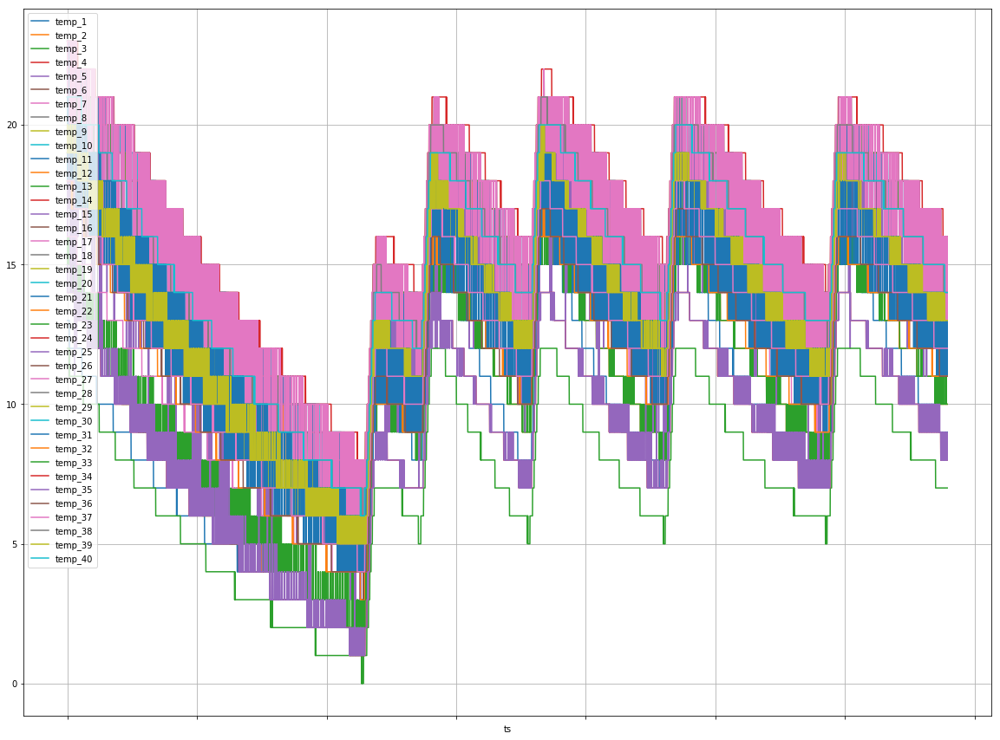

In [305]:
xyz_20181231[xyz_20181231.vin=='LMGHP1S83J1002774'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

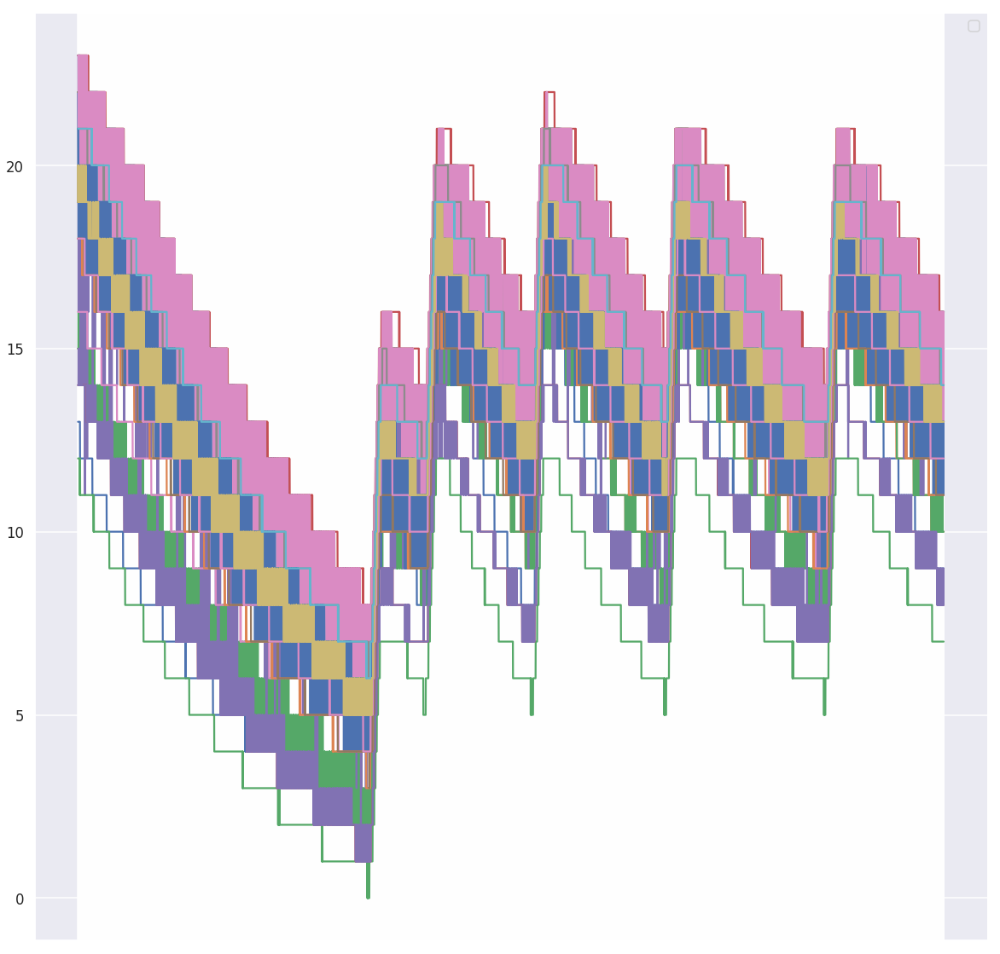

In [309]:
import seaborn as sns
sns.set(rc={"figure.figsize": (20, 20)})
sns.set_context('talk')

f, ax = plt.subplots(1)

ax.plot(xyz_20181231[xyz_20181231.vin=='LMGHP1S83J1002774']['ts'], xyz_20181231[xyz_20181231.vin=='LMGHP1S83J1002774'][temperature_list])
ax.legend(loc=0, frameon=True)
plt.setp(ax.get_xticklabels(), visible=False)
plt.xticks(rotation=0)
sns.despine()

# 20190103

LMGHP1S50J1004469          LMGHP1S82H1000024


In [3]:
import glob

In [6]:
files_20190103 = glob.glob(path + "/temp_and_volt_final_data_90_40_20190103*")

In [7]:
import pandas as pd
all_li_20190103 = []
for filename in files_20190103:
    df_temp = pd.read_csv(filename, index_col=None, header=0)
    print('Read {} records from file {}'.format(len(df_temp), filename))
    all_li_20190103.append(df_temp)

Read 1132032 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20190103_part3.csv.gz
Read 1118549 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20190103_part4.csv.gz
Read 1047080 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20190103_part5.csv.gz
Read 1100302 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20190103_part7.csv.gz
Read 1144448 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20190103_part8.csv.gz
Read 1115384 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20190103_part1.csv.gz
Read 345624 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp

In [8]:
frame_all_20190103 = pd.concat(all_li_20190103, axis=0, ignore_index=True)

In [11]:
frame_all_20190103['ts'] = convert_ts_to_datetime(frame_all_20190103['ts'])

In [12]:
xyz_20190103 = frame_all_20190103.drop(['veh_curr'], axis=1).iloc[:, 0:42]

In [ ]:
#xyz_20190103 = xyz_20181231.reset_index()

In [13]:
xyz_20190103.head(n=2)

,vin,ts,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,LMGHP1S53H1000331,2019-01-03 00:00:05+08:00,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,...,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0,8.0
1,LMGHP1S53H1000524,2019-01-03 00:00:05+08:00,4.0,4.0,4.0,5.0,5.0,5.0,5.0,6.0,...,6.0,5.0,3.0,3.0,3.0,5.0,5.0,5.0,5.0,6.0


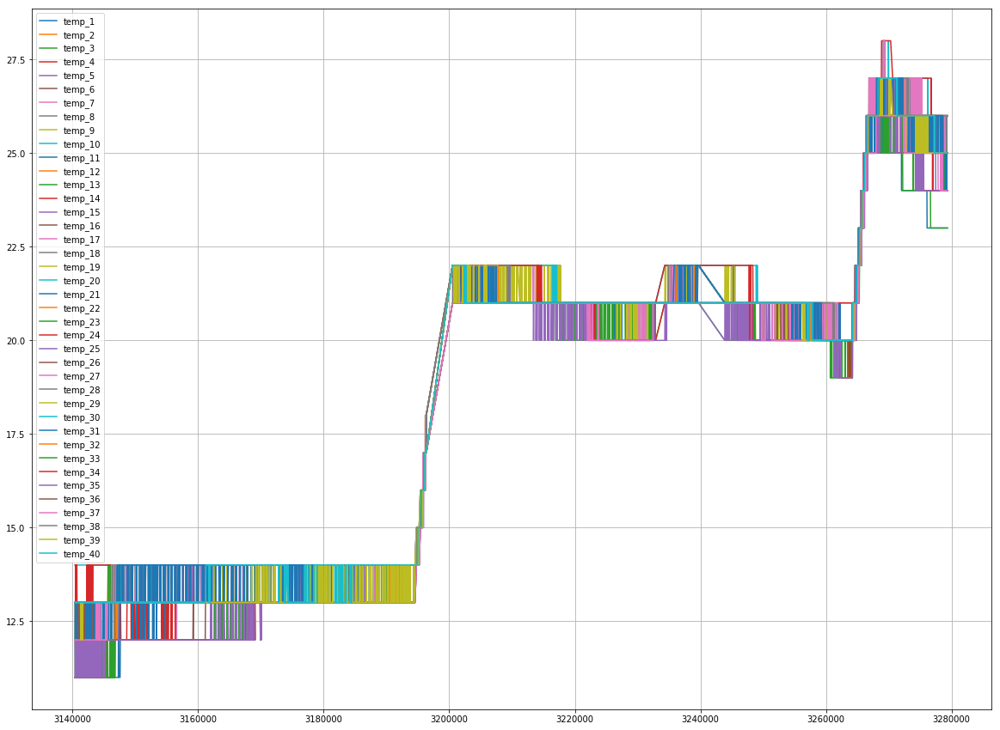

In [18]:
xyz_20190103[xyz_20190103.vin=='LMWHP1S28J1000258'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

In [4]:
from datetime import date, timedelta

def daterange(start_date, end_date):
    for n in range(int((start_date - end_date).days + 1)):
        yield start_date - timedelta(n)

dates = []
latest_date = date.today()
start_date = date(2017, 8, 5)  # need to check for the whole history
for single_date in daterange(latest_date, start_date):
    dates.append(single_date.strftime('%Y%m%d'))

# Guobiao_raw_orc

In [127]:
import pandas as pd

status_file = "/home/prod/data/create_raw_data_table/status/status_guobiao.txt"

existing_date_df = pd.read_csv(status_file, header=None)
existing_date_df.columns = ['day']

In [128]:
#existing_date_df.day = existing_date_df.day.astype(str)

In [129]:
existing_date_list = existing_date_df.day.sort_values().unique().tolist()

In [130]:
existing_date_df.dtypes

day    int64
dtype: object

In [131]:
for day in dates:
    if day in existing_date_list:
        continue
    print(day)
    print(type(day))


20191115
<type 'str'>
20191114
<type 'str'>
20191113
<type 'str'>
20191112
<type 'str'>
20191111
<type 'str'>
20191110
<type 'str'>
20191109
<type 'str'>
20191108
<type 'str'>
20191107
<type 'str'>
20191106
<type 'str'>
20191105
<type 'str'>
20191104
<type 'str'>
20191103
<type 'str'>
20191102
<type 'str'>
20191101
<type 'str'>
20191031
<type 'str'>
20191030
<type 'str'>
20191029
<type 'str'>
20191028
<type 'str'>
20191027
<type 'str'>
20191026
<type 'str'>
20191025
<type 'str'>
20191024
<type 'str'>
20191023
<type 'str'>
20191022
<type 'str'>
20191021
<type 'str'>
20191020
<type 'str'>
20191019
<type 'str'>
20191018
<type 'str'>
20191017
<type 'str'>
20191016
<type 'str'>
20191015
<type 'str'>
20191014
<type 'str'>
20191013
<type 'str'>
20191012
<type 'str'>
20191011
<type 'str'>
20191010
<type 'str'>
20191009
<type 'str'>
20191008
<type 'str'>
20191007
<type 'str'>
20191006
<type 'str'>
20191005
<type 'str'>
20191004
<type 'str'>
20191003
<type 'str'>
20191002
<type 'str'>
20191001
<

20180322
<type 'str'>
20180321
<type 'str'>
20180320
<type 'str'>
20180319
<type 'str'>
20180318
<type 'str'>
20180317
<type 'str'>
20180316
<type 'str'>
20180315
<type 'str'>
20180314
<type 'str'>
20180313
<type 'str'>
20180312
<type 'str'>
20180311
<type 'str'>
20180310
<type 'str'>
20180309
<type 'str'>
20180308
<type 'str'>
20180307
<type 'str'>
20180306
<type 'str'>
20180305
<type 'str'>
20180304
<type 'str'>
20180303
<type 'str'>
20180302
<type 'str'>
20180301
<type 'str'>
20180228
<type 'str'>
20180227
<type 'str'>
20180226
<type 'str'>
20180225
<type 'str'>
20180224
<type 'str'>
20180223
<type 'str'>
20180222
<type 'str'>
20180221
<type 'str'>
20180220
<type 'str'>
20180219
<type 'str'>
20180218
<type 'str'>
20180217
<type 'str'>
20180216
<type 'str'>
20180215
<type 'str'>
20180214
<type 'str'>
20180213
<type 'str'>
20180212
<type 'str'>
20180211
<type 'str'>
20180210
<type 'str'>
20180209
<type 'str'>
20180208
<type 'str'>
20180207
<type 'str'>
20180206
<type 'str'>
20180205
<

# 20181230

In [5]:
import glob

In [6]:
path = '/name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV' 

In [7]:
files_20181230 = glob.glob(path + "/temp_and_volt_final_data_90_40_20181230*")

In [8]:
import pandas as pd
all_li_20181230 = []
for filename in files_20181230:
    df_temp = pd.read_csv(filename, index_col=None, header=0)
    print('Read {} records from file {}'.format(len(df_temp), filename))
    all_li_20181230.append(df_temp)

Read 1147457 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181230_part6.csv.gz
Read 1185858 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181230_part3.csv.gz
Read 1149404 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181230_part7.csv.gz
Read 1229951 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181230_part2.csv.gz
Read 1193731 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181230_part1.csv.gz
Read 1240368 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp_and_volt_final_data_90_40_20181230_part4.csv.gz
Read 480910 records from file /name-node-raid/raw_temperature_voltage_readings/final_data/A5HEV/temp

In [9]:
frame_all_20181230 = pd.concat(all_li_20181230, axis=0, ignore_index=True)

In [12]:
frame_all_20181230['ts'] = convert_ts_to_datetime(frame_all_20181230['ts'])

In [13]:
frame_all_20181230.head(n=3)

,vin,ts,veh_curr,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,...,volt_81,volt_82,volt_83,volt_84,volt_85,volt_86,volt_87,volt_88,volt_89,volt_90
0,LMGHP1S57J1002315,2018-12-30 08:00:05,7.0,8.0,9.0,9.0,12.0,13.0,13.0,13.0,...,3.696,3.694,3.695,3.699,3.698,3.689,3.698,3.700,3.701,3.700
1,LMWHP1S22J1000515,2018-12-30 08:00:05,-31.5,16.0,17.0,17.0,19.0,19.0,19.0,19.0,...,3.683,3.679,3.681,3.681,3.683,3.680,3.680,3.682,3.681,3.681
2,LMGHP1S57H1001126,2018-12-30 08:00:05,-5.5,8.0,9.0,9.0,11.0,11.0,12.0,12.0,...,3.984,3.981,3.979,3.980,3.984,3.984,3.984,3.982,3.983,3.982


In [29]:
temperature_list = ["temp_" + str(s) for s in range(1,41)]

In [14]:
voltage_list = ["volt_" + str(s) for s in range(1,91)]

In [ ]:
xyz_20181230 = frame_all_20181230.drop(['veh_curr'], axis=1).iloc[:, 0:42]

In [ ]:
xyz_20181230 = xyz_20181230.set_index('ts')

In [41]:
xyz_20181230.to_csv("xyz_20181230.csv")

In [4]:
import pandas as pd
xyz_20181230 = pd.read_csv("old_files/xyz_20181230.csv")

In [5]:
xyz_20181230.head(n=3)

,ts,vin,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,2018-12-30 00:00:05+08:00,LMGHP1S57J1002315,8.0,9.0,9.0,12.0,13.0,13.0,13.0,16.0,...,16.0,14.0,9.0,11.0,11.0,14.0,14.0,15.0,15.0,16.0
1,2018-12-30 00:00:05+08:00,LMWHP1S22J1000515,16.0,17.0,17.0,19.0,19.0,19.0,19.0,20.0,...,20.0,19.0,17.0,17.0,17.0,19.0,19.0,20.0,20.0,20.0
2,2018-12-30 00:00:05+08:00,LMGHP1S57H1001126,8.0,9.0,9.0,11.0,11.0,12.0,12.0,14.0,...,13.0,10.0,5.0,7.0,7.0,10.0,10.0,12.0,12.0,14.0


In [34]:
import matplotlib.pyplot as plt

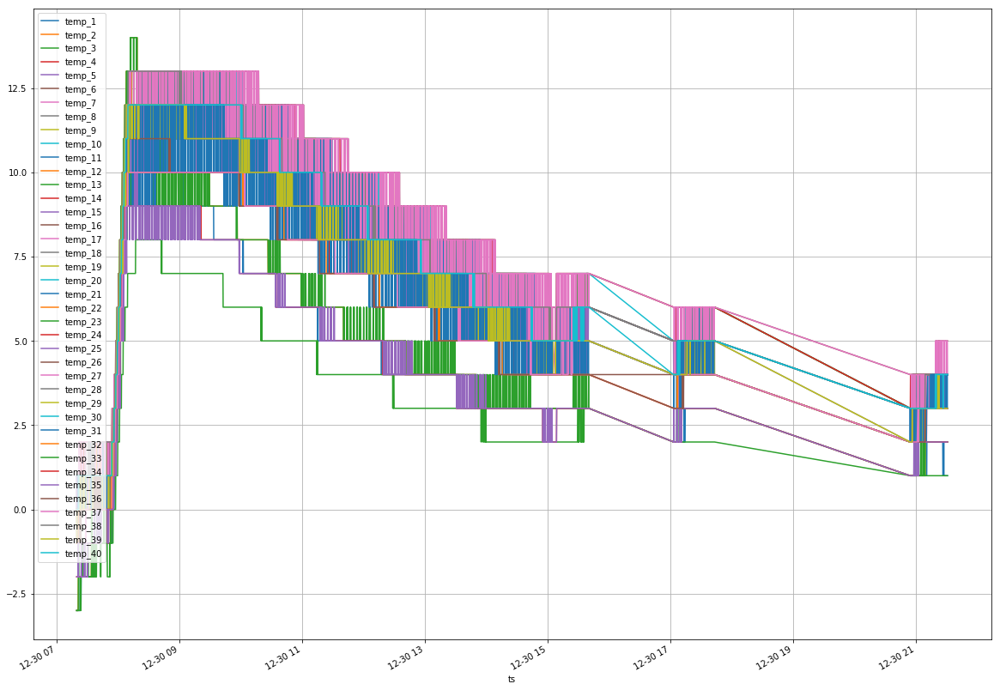

In [43]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S50H1000240'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

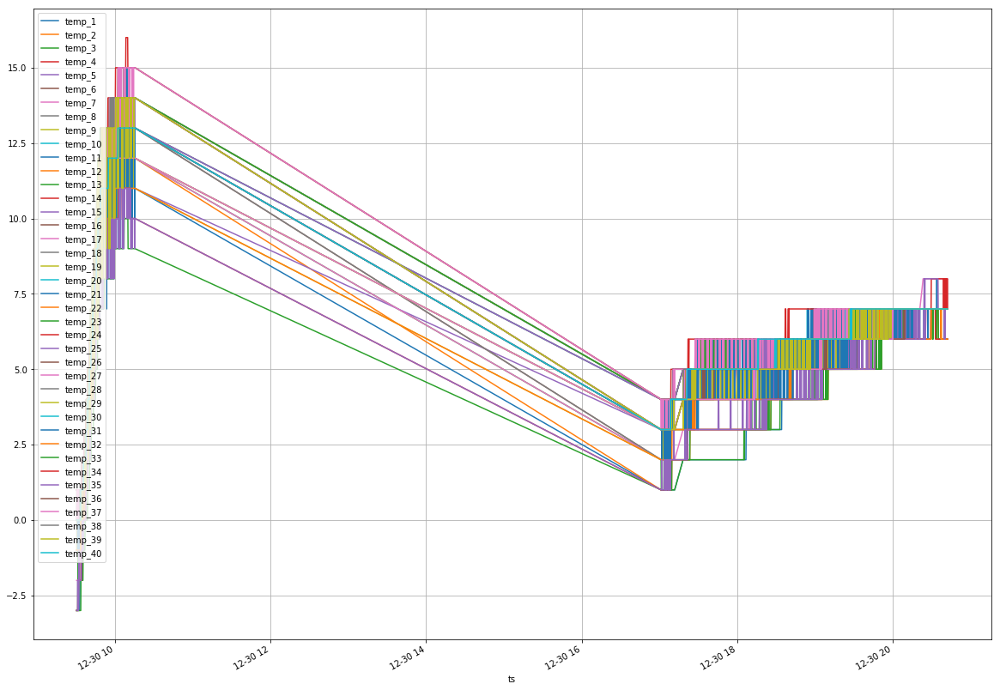

In [44]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S54H1000547'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

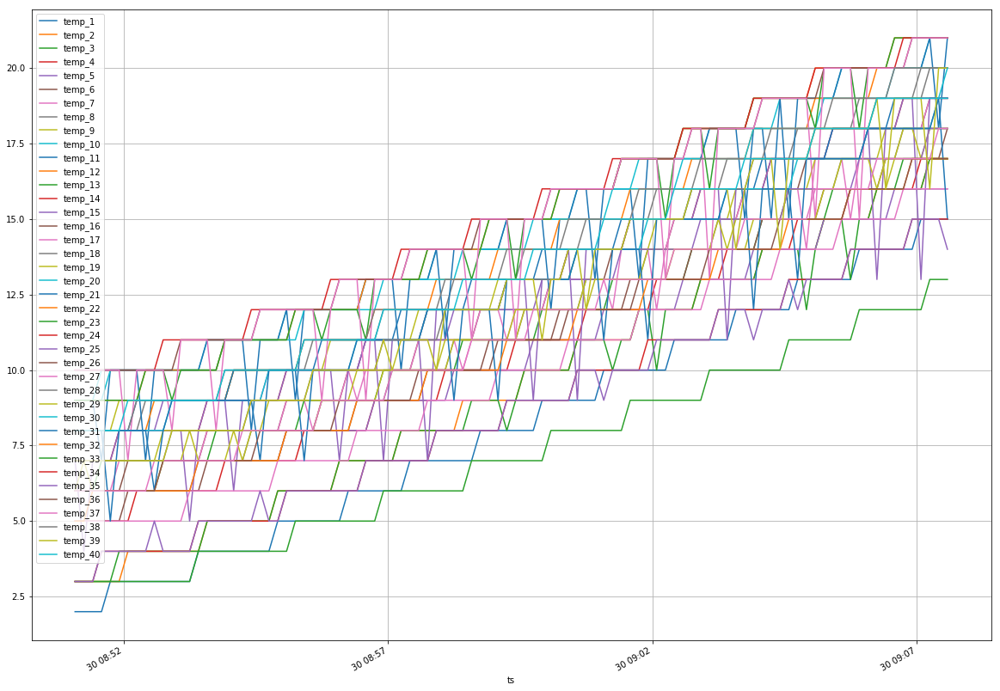

In [149]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][temperature_list][1900:2000].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

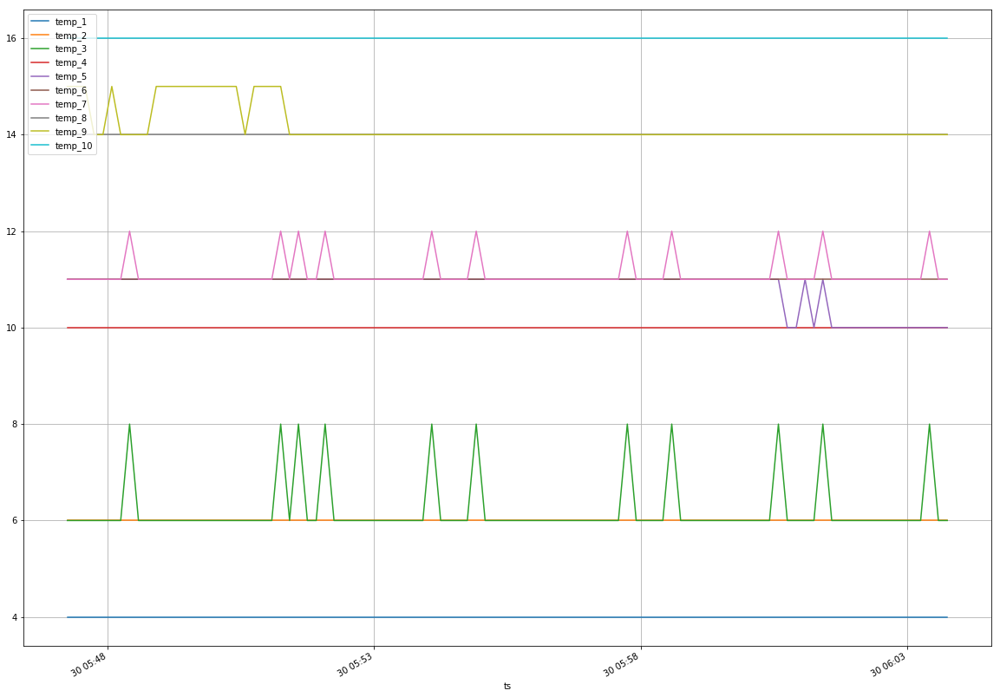

In [77]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][temperature_list1][800:900].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

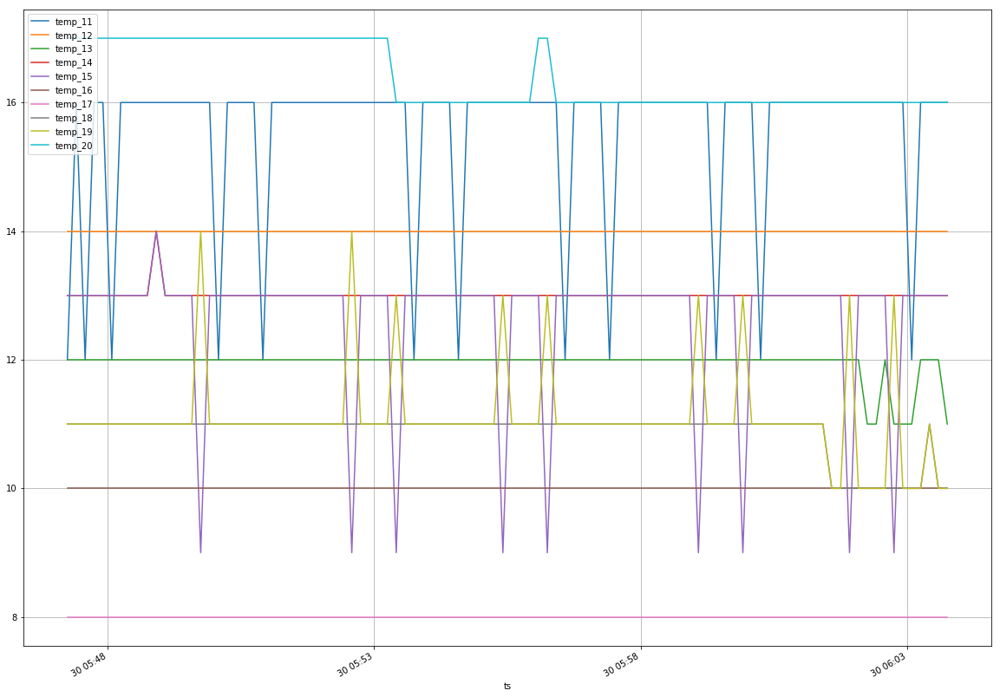

In [78]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][temperature_list2][800:900].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

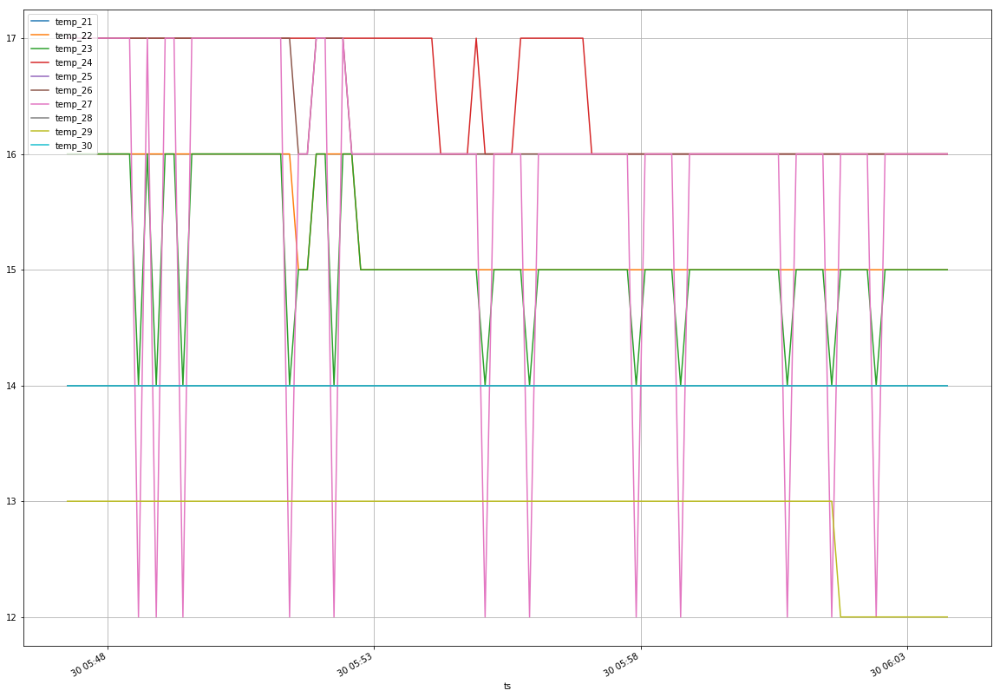

In [79]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][temperature_list3][800:900].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

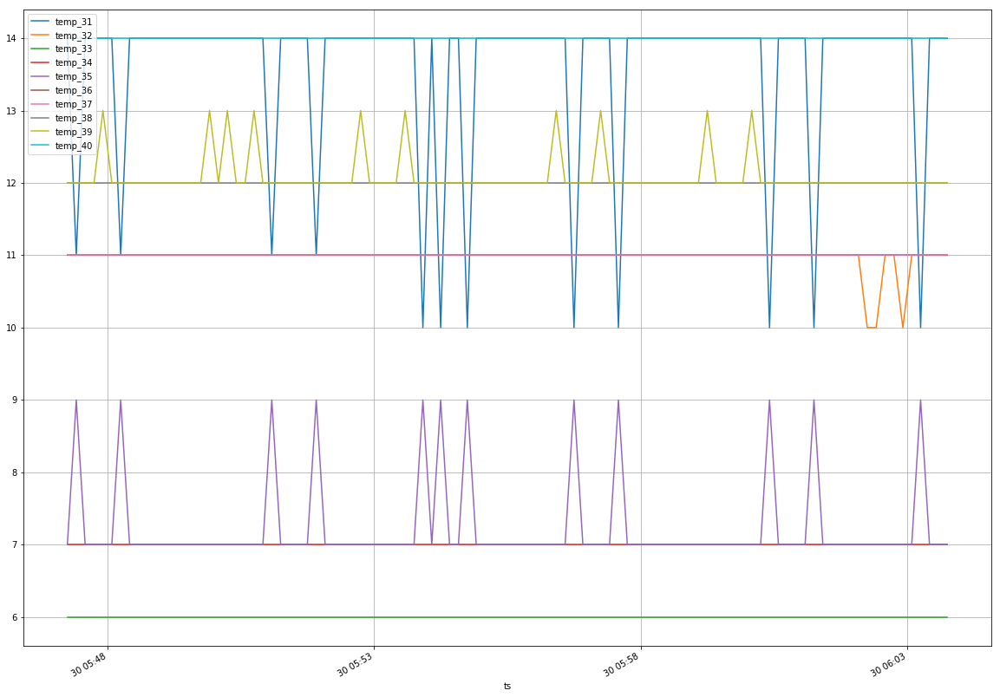

In [80]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][temperature_list4][800:900].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

In [28]:
temperature_list1 = ["temp_" + str(s) for s in range(1,11)]
temperature_list2 = ["temp_" + str(s) for s in range(11,21)]
temperature_list3 = ["temp_" + str(s) for s in range(21,31)]
temperature_list4 = ["temp_" + str(s) for s in range(31,41)]

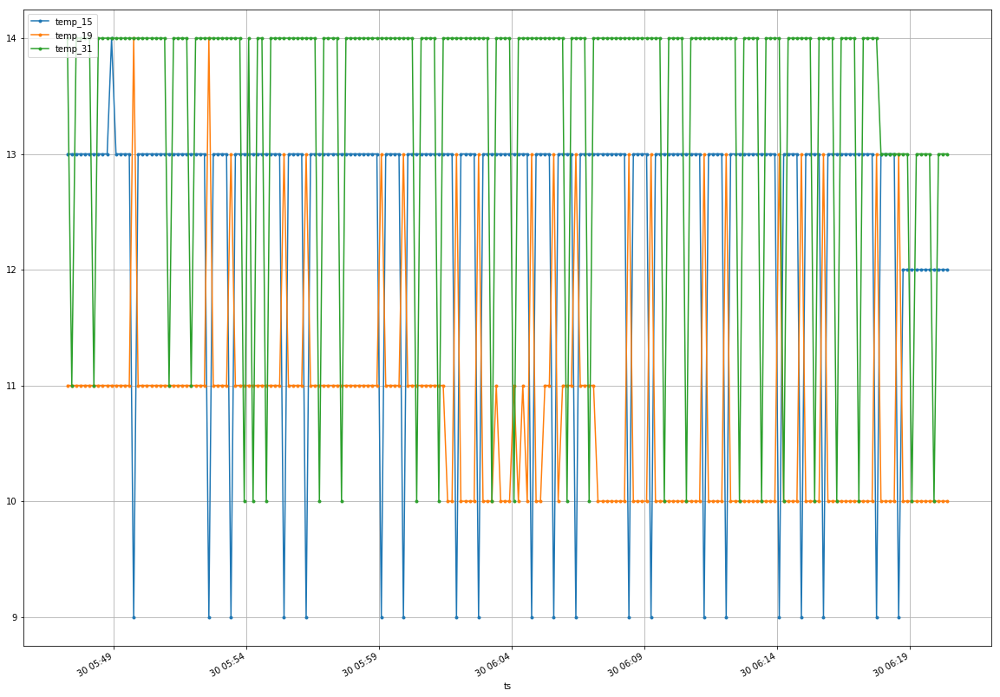

In [107]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][['temp_15','temp_19', 'temp_31']][800:1000].plot(figsize=(20, 15), grid=True, marker='.')
plt.legend(loc='upper left')

In [8]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S52J1002559'][['temp_15', 'temp_16']].iplot()

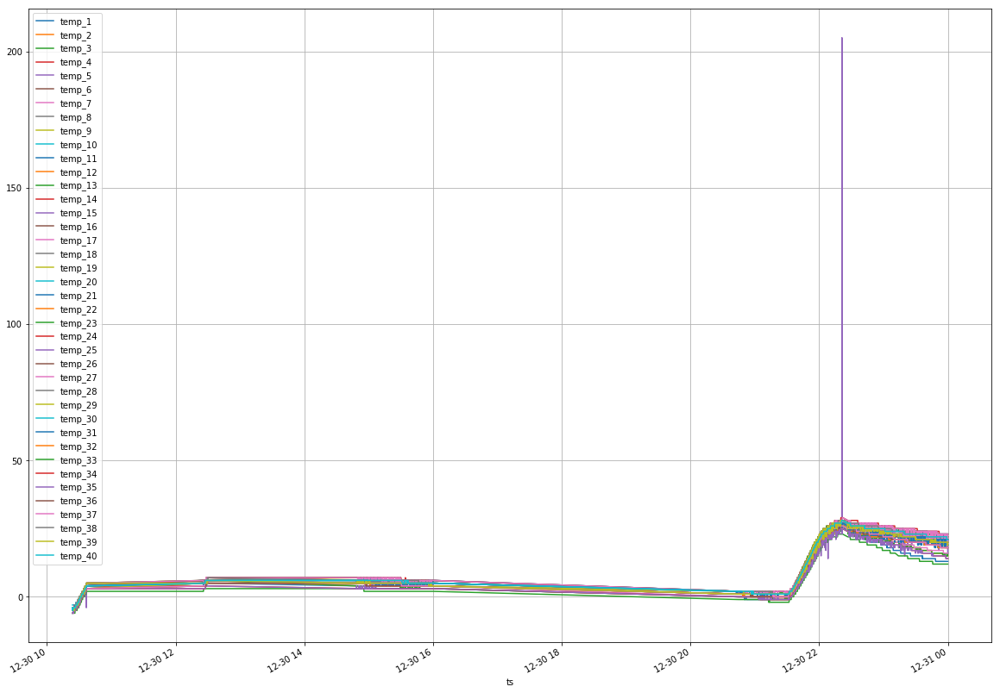

In [65]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S83J1002774'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

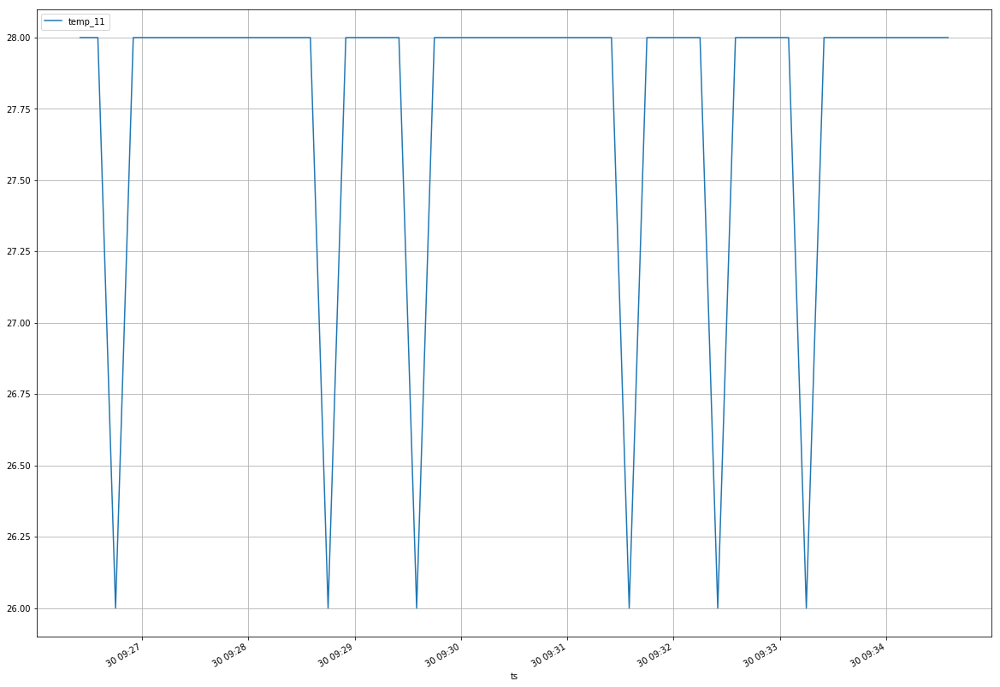

In [143]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S56J1002872']['temp_11'][500:550].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

In [10]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S56J1002872'][['temp_11','temp_12']].iplot()

In [6]:
xyz = xyz_20181230

In [7]:
array_of_vins = xyz.vin.unique()

In [8]:
list_of_vins = array_of_vins.tolist()

In [9]:
len(list_of_vins)

3644

In [10]:
xyz = xyz.reset_index()

In [11]:
xyz['ts'] = pd.to_datetime(xyz['ts'], errors='coerce')

In [15]:
import itertools as it

In [16]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
#xyz = xyz.reset_index()

result_list = []

for vin in random.sample(list_of_vins, 100):
#for vin in list_of_vins:
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)

    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff(periods=6).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff(periods=6).iloc[1:]
    
    rate_df = temp_diff.div(ts_diff, axis=0)

    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    
    result_list.append(rate_series)
    

    ttt_diff = rate_df.abs().describe().T
    max_value = ttt_diff['max']
    

    max_prod_of_75_and_max = max_value.max()
    dic[vin] = max_prod_of_75_and_max
    print("Vin #" + str(i) + ":" + vin + ", the max changing rate is " + str(max_prod_of_75_and_max))

Vin #1:LMGHP1S50J1003127, the max changing rate is 0.3333333333333333
Vin #2:LMGHP1S56J1004122, the max changing rate is 0.16666666666666666
Vin #3:LMGHP1S57J1003903, the max changing rate is 0.16666666666666666
Vin #4:LMGHP1S51H1001798, the max changing rate is 0.16666666666666666
Vin #5:LMWHP1S24J1000418, the max changing rate is 0.5
Vin #6:LMGHP1S51H1001087, the max changing rate is 0.5
Vin #7:LMGHP1S8XJ1004389, the max changing rate is 0.16666666666666666
Vin #8:LMGHP1S87H1001573, the max changing rate is 0.16666666666666666
Vin #9:LMWHP1S21J1000084, the max changing rate is 0.5
Vin #10:LMGHP1S55J1002751, the max changing rate is 0.16666666666666666
Vin #11:LMGHP1S52J1002030, the max changing rate is 0.16666666666666666
Vin #12:LMGHP1S56H1000985, the max changing rate is 0.5
Vin #13:LMGHP1S5XH1001346, the max changing rate is 0.16666666666666666
Vin #14:LMGHP1S50J1002074, the max changing rate is 0.6666666666666666
Vin #15:LMGHP1S54H1000306, the max changing rate is 1.0
Vin #16:LMG

In [17]:
df_rate_1min = pd.concat(result_list)

In [18]:
df_rate_1min.to_csv("df_rate_1min_sample.csv")

In [21]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
#xyz = xyz.reset_index()

result_list = []

for vin in random.sample(list_of_vins, 100):
#for vin in list_of_vins:
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)

    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff(periods=6).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff(periods=6).iloc[1:]
    
    rate_df = temp_diff.div(ts_diff, axis=0)

    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    
    result_list.append(rate_series)
    

    ttt_diff = rate_df.abs().describe().T
    max_value = ttt_diff['max']

    max_prod_of_75_and_max = max_value.max()
    dic[vin] = max_prod_of_75_and_max
    print("Vin #" + str(i) + ":" + vin + ", the max changing rate is " + str(max_prod_of_75_and_max))

NameError: name 'temperature_list' is not defined

In [ ]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

#xyz = xyz.reset_index()

for vin in sample_list_of_vins:
    vin_df = xyz[xyz.vin == vin]
    
    #discard vins with records < 50
    #if vin_df['ts'].count() < 50:
    if len(vin_df.index) < 50:
        i = i + 1
        print("......")
        print("Vin #" + str(i) + ":" + vin + ", row number is too small!")
        continue
    
    i = i + 1
    #sort first for taking diff
    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')
    #vin_df = vin_df.reset_index()
    vin_df = vin_df.set_index(["ts"], inplace = False)

    #get rate for every time interval
    #ts_diff = ttt['ts'].diff().iloc[1:].dt.seconds.div(10, fill_value=0) 
    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff().iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff().iloc[1:]
    rate_df = temp_diff.div(ts_diff, axis=0)

    # find any vin with rate > rate_to_check
    print("......")
    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    rate_series.columns = ['temp_change_rate']
    if (rate_series['temp_change_rate'] > rate_to_check).any() == True:
        suspect_vin.add(vin)
    
    # generate histogram
    rate_list.append(rate_df)
    
    ttt_diff = rate_df.diff().abs().describe().T
    max_value = ttt_diff['max']
    #max_prod_of_75_and_max = (max_value.max() / (max_value.mean() + 1.0) )
    max_prod_of_75_and_max = (max_value.max() / (max_value.quantile(.9) + 1.0) )  
    dic[vin] = max_prod_of_75_and_max
    print("Vin #" + str(i) + ":" + vin + ", the abnormaly score is " + str(max_prod_of_75_and_max))
    
    if max_prod_of_75_and_max > anomaly_to_check:
        print("......")
        print("Detected vin with anomaly sensors:" + vin + ":")
        rate_df.to_csv(vin + ".csv")
        
        ts_list = []
        
        for i, row in rate_df.iterrows():
            ts = i
            for col in rate_df.columns:
                if (row[col] > rate_to_check) == True:
                    ts_list.append(ts)
                    print("Detected rate > " + str(rate_to_check) + " for " + col + " at timestamp " + str(ts))
        
        t1 = ts_list[0]
        t2 = ts_list[-1]
        anomaly_duration = pd.Timedelta(t2 - t1).seconds / 60.0 
        print("Anomaly situation lasts for " + str(anomaly_duration) + " minutes.")
        
#concat to df for histogram
rate_20181230_df = pd.concat(rate_list, ignore_index=True)
rate_20181230_df.to_csv("rate_20181230_df.csv")

print("......")
print("print all the suspect vins with rate grater than :" + str(rate_to_check))
for vin,value in dic.items():
    if vin in suspect_vin:
         print(vin, value)

In [ ]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
#xyz = xyz.reset_index()

result_list = []

for vin in random.sample(list_of_vins, 100):
#for vin in list_of_vins:
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)

    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff(periods=6).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff(periods=6).iloc[1:]
    
    rate_df = temp_diff.div(ts_diff, axis=0)

    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    
    result_list.append(rate_series)
    

    ttt_diff = rate_df.abs().describe().T
    max_value = ttt_diff['max']

    max_prod_of_75_and_max = max_value.max()
    dic[vin] = max_prod_of_75_and_max
    print("Vin #" + str(i) + ":" + vin + ", the max changing rate is " + str(max_prod_of_75_and_max))

In [86]:
all_rate_20181230_df_1 = pd.concat(result_list, ignore_index=True)

In [ ]:
import pandas as pd
df_rate_1min = pd.read_csv("df_rate_1min.csv")

In [1]:
import pandas as pd 
df = pd.DataFrame()
i = 0
for chunk in pd.read_csv('df_rate_1min.csv', header=0, names=['rate'], chunksize=1000000):
    i = i+1
    df = pd.concat([df, chunk], ignore_index=True)
    print("chunk " + str(i) + " done!")

chunk 1 done!
chunk 2 done!
chunk 3 done!
chunk 4 done!
chunk 5 done!
chunk 6 done!
chunk 7 done!
chunk 8 done!
chunk 9 done!
chunk 10 done!
chunk 11 done!
chunk 12 done!
chunk 13 done!
chunk 14 done!
chunk 15 done!
chunk 16 done!
chunk 17 done!
chunk 18 done!
chunk 19 done!
chunk 20 done!
chunk 21 done!
chunk 22 done!
chunk 23 done!
chunk 24 done!
chunk 25 done!
chunk 26 done!
chunk 27 done!
chunk 28 done!
chunk 29 done!
chunk 30 done!
chunk 31 done!
chunk 32 done!
chunk 33 done!
chunk 34 done!
chunk 35 done!
chunk 36 done!
chunk 37 done!
chunk 38 done!
chunk 39 done!
chunk 40 done!
chunk 41 done!
chunk 42 done!
chunk 43 done!
chunk 44 done!
chunk 45 done!
chunk 46 done!
chunk 47 done!
chunk 48 done!
chunk 49 done!
chunk 50 done!
chunk 51 done!
chunk 52 done!
chunk 53 done!
chunk 54 done!
chunk 55 done!
chunk 56 done!
chunk 57 done!
chunk 58 done!
chunk 59 done!
chunk 60 done!
chunk 61 done!
chunk 62 done!
chunk 63 done!
chunk 64 done!
chunk 65 done!
chunk 66 done!
chunk 67 done!
chun

In [ ]:
df_rate_1min.columns = ["rate1", "rate2"]

In [ ]:
df_rate_1min = df_rate_1min.drop(df_rate_1min.columns[0],axis=1)

In [19]:
df_rate_1min.head(n=3)

,0
0,NaN
1,NaN
2,NaN


In [20]:
all_rate_20181230_df_1 = df_rate_1min 
all_rate_20181230_df_1.columns = ["rate"]

In [24]:
len(all_rate_20181230_df_1)

9170520

In [28]:
rate_20181230_df_1 = all_rate_20181230_df_1[all_rate_20181230_df_1.rate.notnull()]#.ix[all_rate_20181230_df_1['rate'] > 0]

In [33]:
rate_20181230_df_1 = rate_20181230_df_1.ix[rate_20181230_df_1['rate'] > 0]

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


In [29]:
import seaborn as sns

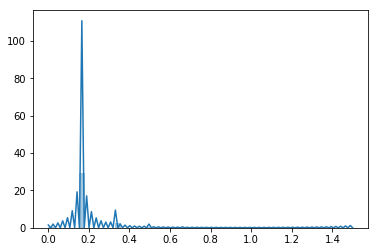

In [34]:
ax = sns.distplot(rate_20181230_df_1)

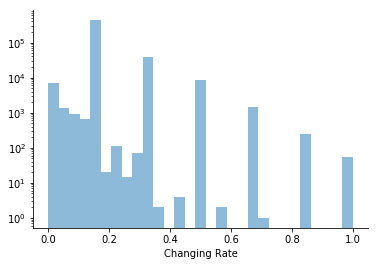

In [35]:
import matplotlib.pyplot as plt
import numpy as np

bins = np.linspace(0, 1, 30)

fig, axs = plt.subplots()

axs.hist(rate_20181230_df_1['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

#plt.xscale('log')
plt.yscale('log')
axs.set_xlabel('Changing Rate')
sns.despine()

In [16]:
title = 'Changing rate distribution'
sns.set(rc={"figure.figsize": (15, 12)})
sns.set_context('talk')

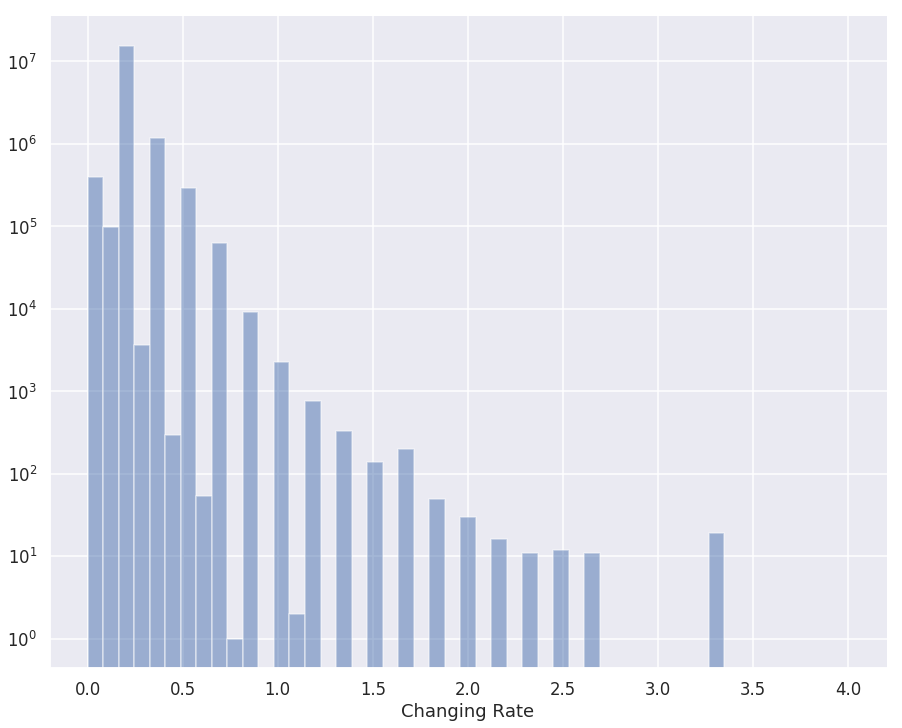

In [41]:
bins = np.linspace(0, 4, 50)

fig, axs = plt.subplots()

axs.hist(rate_20181230_df_1['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Changing Rate')
sns.despine()

In [22]:
IQR = rate_20181230_df_1.rate.quantile(0.75) - rate_20181230_df_1.rate.quantile(0.25)

In [49]:
rate_20181230_df_1.describe()

,rate
count,1.754920e+07
mean,1.824588e-01
std,8.597963e-02
min,1.548707e-04
25%,1.666667e-01
50%,1.666667e-01
75%,1.666667e-01
max,3.333333e+01


In [36]:
rate_20181230_df_1.describe()

,rate
count,490149.000000
mean,0.184350
std,0.072836
min,0.000390
25%,0.166667
50%,0.166667
75%,0.166667
max,1.500000


In [37]:
rate_20181230_df_1.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.333333
0.98,0.500000
0.99,0.500000


In [23]:
#Using the IQR, we calculate the upper boundary using the formulas 
upper_limit = rate_20181230_df_1.rate.quantile(0.75) + (IQR * 1.5)
upper_limit_extreme = rate_20181230_df_1.rate.quantile(0.75) + (IQR * 3)
upper_limit, upper_limit_extreme

(0.16666666666666666, 0.16666666666666666)

In [24]:
#Now, let’s see the ratio of data points above the upper limit & extreme upper limit. ie, the outliers.
total = np.float(rate_20181230_df_1.shape[0])
print('rate > 0.167: {}'.format(rate_20181230_df_1[rate_20181230_df_1.rate>0.167].shape[0]/total))
print('rate > 0.166: {}'.format(rate_20181230_df_1[rate_20181230_df_1.rate>0.166].shape[0]/total))

rate > 0.167: 0.0886470089034
rate > 0.166: 0.971990744421


In [25]:
#Using the IQR, we calculate the lower boundary using the formulas 
lower_limit = rate_20181230_df_1.rate.quantile(0.25) - (IQR * 1.5)
lower_limit_extreme = rate_20181230_df_1.rate.quantile(0.25) - (IQR * 3)
lower_limit, lower_limit_extreme

(0.16666666666666666, 0.16666666666666666)

In [26]:
from scipy import stats

In [27]:
z = stats.zscore(rate_20181230_df_1.rate)

In [28]:
print(np.where(z > 3))

(array([   17690,    17691,    17692, ..., 17549196, 17549197, 17549198]),)


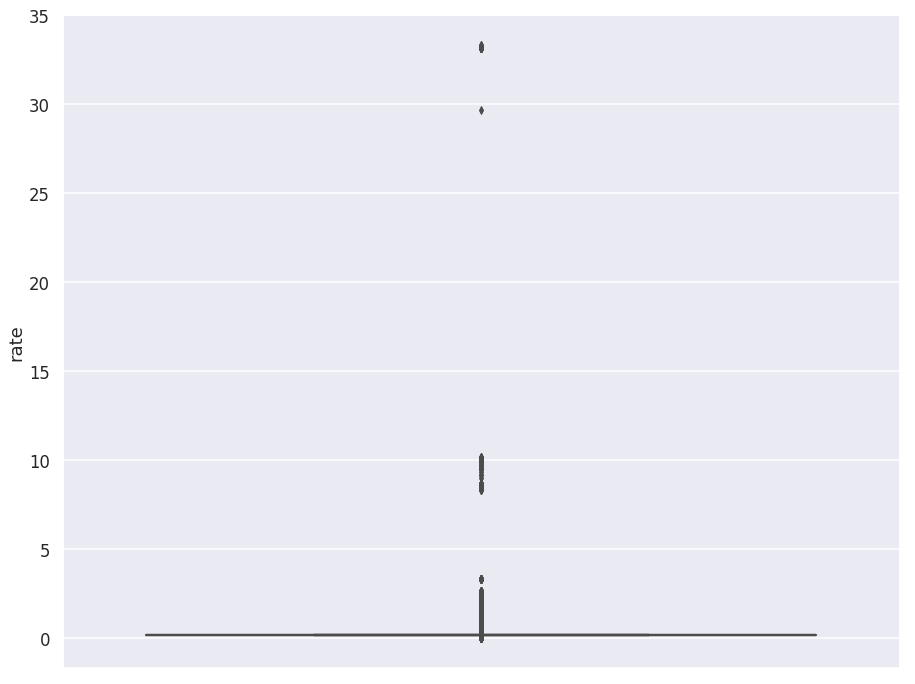

In [29]:
sns.boxplot(y='rate', data = rate_20181230_df_1)

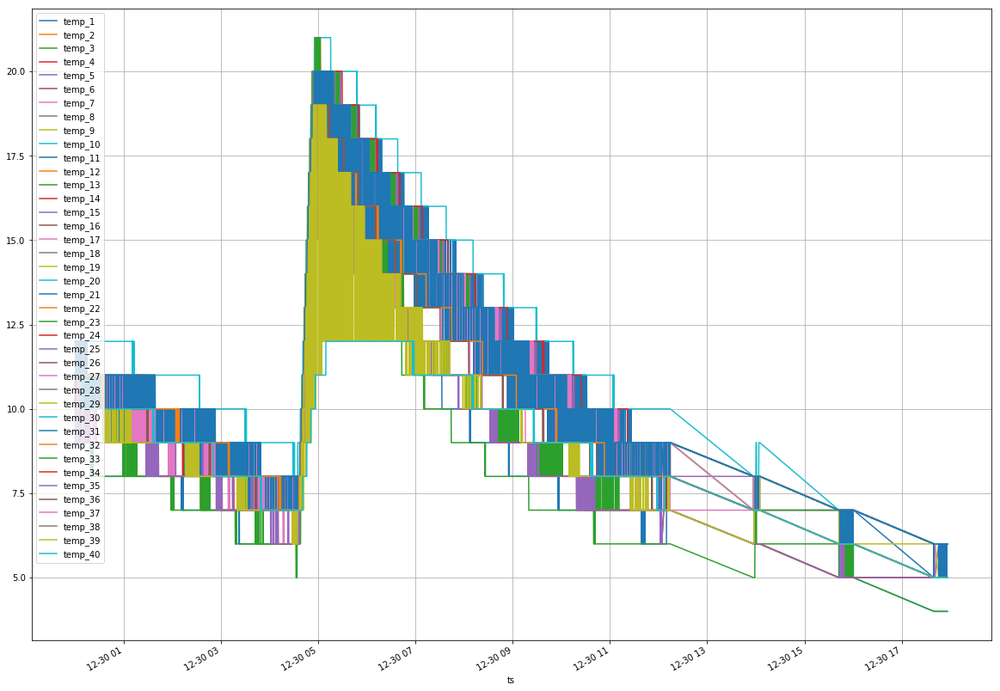

In [164]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S58J1004638'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

In [15]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S58J1004638'][temperature_list].iplot()

In [35]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S58J1004638'][['temp_35']].iplot()

In [20]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S51J1003086']['temp_39'].iplot()

In [53]:
xyz_20181230 = xyz_20181230.set_index('ts')

In [47]:
xyz_20181230[xyz_20181230.vin=='LMWHP1S25J1000430'][['temp_24']].iplot()

In [49]:
xyz_20181230 = xyz_20181230.reset_index()

In [51]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(
       # mode='markers',
        mode = "lines+markers",
x=xyz_20181230[xyz_20181230.vin=='LMWHP1S25J1000430']['ts'], y=xyz_20181230[xyz_20181230.vin=='LMWHP1S25J1000430']['temp_24'],
        opacity=0.5,
        marker=dict(
            color='LightSkyBlue',
            size=1,
            line=dict(
                color='MediumPurple',
                width=2
            )
        ),
        name='Opacity 0.5'
    )
)



fig.show()

In [54]:
xyz_20181230[xyz_20181230.vin=='LMGHP1S51J1003086'][temperature_list].iplot()

# 2 分钟

In [52]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
#xyz = xyz.reset_index()

result_list = []

for vin in random.sample(list_of_vins, 100):
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)

    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff(periods=12).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff(periods=12).iloc[1:]
    
    rate_df = temp_diff.div(ts_diff, axis=0)

    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    
    result_list.append(rate_series)
"""    
    ttt_diff = rate_df.abs().describe().T
    max_value = ttt_diff['max']

    max_prod_of_75_and_max = max_value.max()
    dic[vin] = max_prod_of_75_and_max
    print("Vin #" + str(i) + ":" + vin + ", the max changing rate is " + str(max_prod_of_75_and_max))
"""

'    \n    ttt_diff = rate_df.abs().describe().T\n    max_value = ttt_diff[\'max\']\n\n    max_prod_of_75_and_max = max_value.max()\n    dic[vin] = max_prod_of_75_and_max\n    print("Vin #" + str(i) + ":" + vin + ", the max changing rate is " + str(max_prod_of_75_and_max))\n'

In [53]:
all_rate_20181230_df_2 = pd.concat(result_list, ignore_index=True)

In [54]:
all_rate_20181230_df_2.columns = ["rate"]

In [55]:
all_rate_20181230_df_2.to_csv("all_rate_20181230_df_2.csv")

In [1]:
import pandas as pd
all_rate_20181230_df_2 = pd.read_csv("df_rate_2min.csv")

In [2]:
rate_20181230_df_2 = all_rate_20181230_df_2[all_rate_20181230_df_2.rate.notnull()].ix[all_rate_20181230_df_2['rate'] > 0]

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


In [57]:
rate_20181230_df_2.describe()

,rate
count,685093.000000
mean,0.099898
std,0.043184
min,0.000253
25%,0.083333
50%,0.083333
75%,0.083333
max,0.750000


In [3]:
rate_20181230_df_2.quantile([.95, .98, .99], axis = 0)

,Unnamed: 0,rate
0.95,9431236.40,0.166667
0.98,9619537.16,0.166667
0.99,9626388.08,0.250000


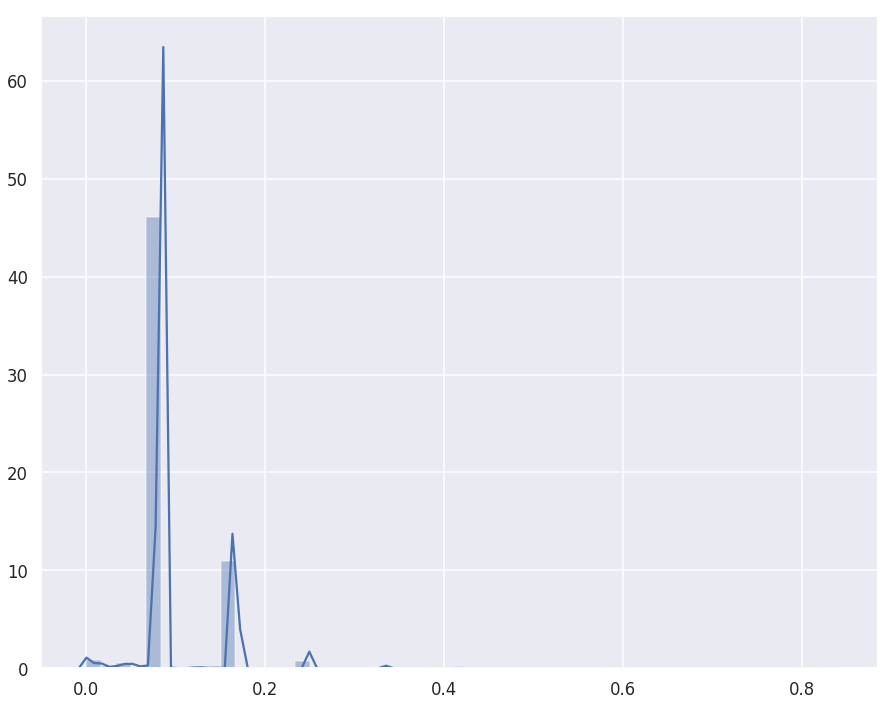

In [226]:
ax = sns.distplot(rate_20181230_df_2)

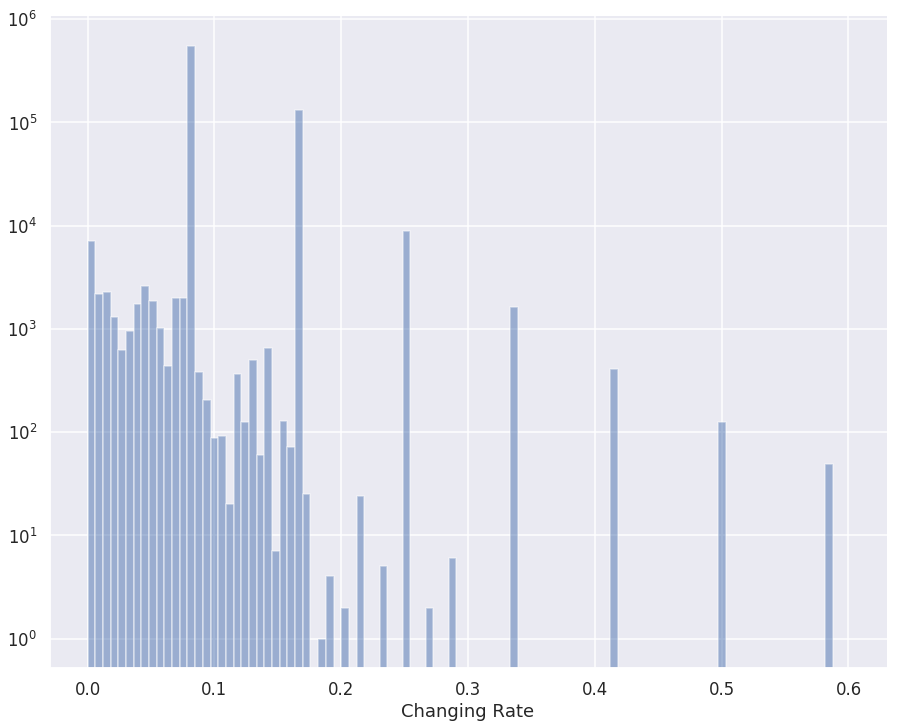

In [229]:
bins = np.linspace(0, 0.6, 100)

fig, axs = plt.subplots()

axs.hist(rate_20181230_df_2['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Changing Rate')
sns.despine()

# 5分钟

In [59]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
#xyz = xyz.reset_index()

result_list = []

for vin in random.sample(list_of_vins, 100):
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)

    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff(periods=30).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff(periods=30).iloc[1:]
    
    rate_df = temp_diff.div(ts_diff, axis=0)

    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    
    result_list.append(rate_series)
    
    ttt_diff = rate_df.abs().describe().T
    max_value = ttt_diff['max']

    max_prod_of_75_and_max = max_value.max()
    dic[vin] = max_prod_of_75_and_max
    print("Vin #" + str(i) + ":" + vin + ", the max changing rate is " + str(max_prod_of_75_and_max))

Vin #1:LMGHP1S57J1003464, the max changing rate is 0.23333333333333334
Vin #2:LMGHP1S58J1002100, the max changing rate is 0.03333333333333333
Vin #3:LMGHP1S89J1003833, the max changing rate is 0.2
Vin #4:LMGHP1S86H1000060, the max changing rate is 0.23333333333333334
Vin #5:LMGHP1S57H1001837, the max changing rate is 0.1
Vin #6:LMGHP1S53J1002862, the max changing rate is 0.2
Vin #7:LMGHP1S5XJ1003331, the max changing rate is 0.4
Vin #8:LMGHP1S54H1001357, the max changing rate is 0.23333333333333334
Vin #9:LMGHP1S82H1001593, the max changing rate is 0.06666666666666667
Vin #10:LMGHP1S58H1001281, the max changing rate is 0.2
Vin #11:LMGHP1S89H1000196, the max changing rate is 0.16666666666666666
Vin #12:LMGHP1S59J1002428, the max changing rate is 0.3
Vin #13:LMGHP1S52H1001020, the max changing rate is 0.03333333333333333
Vin #14:LMWHP1S28J1000177, the max changing rate is 0.1
Vin #15:LMGHP1S81J1002398, the max changing rate is nan
Vin #16:LMGHP1S53J1002361, the max changing rate is 0.233

In [60]:
all_rate_20181230_df_5 = pd.concat(result_list, ignore_index=True)

In [61]:
all_rate_20181230_df_5.columns = ["rate"]

In [62]:
all_rate_20181230_df_5.to_csv("all_rate_20181230_df_5.csv")

In [75]:
import pandas as pd
#all_rate_20181230_df_5 = pd.read_csv("all_rate_20181230_df_5.csv")
all_rate_20181230_df_5 = pd.read_csv("df_rate_5min.csv")

In [76]:
rate_20181230_df_5 = all_rate_20181230_df_5[all_rate_20181230_df_5.rate.notnull()].ix[all_rate_20181230_df_5['rate'] > 0]

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


In [77]:
df_rate_5min = rate_20181230_df_5.drop(rate_20181230_df_5.columns[0],axis=1)

In [78]:
df_rate_5min.columns = ["rate"]

In [6]:
df_rate_5min['new_rate']=(df_rate_5min['rate']-df_rate_5min['rate'].min())/(df_rate_5min['rate'].max()-df_rate_5min['rate'].min())

In [7]:
import seaborn as sns
ax = sns.distplot(df_rate_5min['new_rate'])

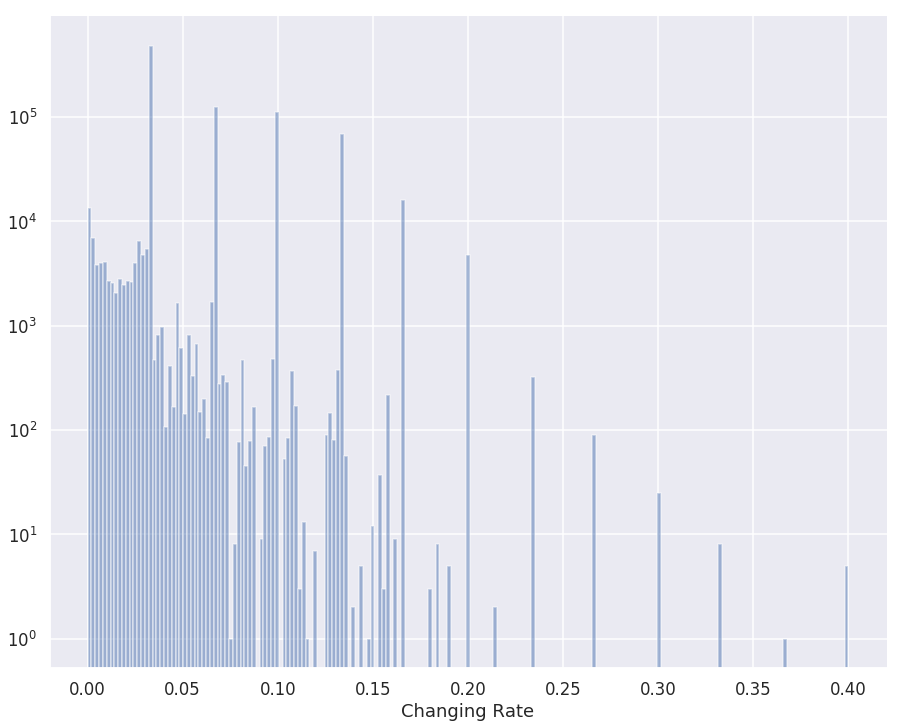

In [9]:
title = 'Changing rate distribution'
sns.set(rc={"figure.figsize": (15, 12)})
sns.set_context('talk')

import numpy as np
import matplotlib.pyplot as plt

bins = np.linspace(0, 0.4, 200)

fig, axs = plt.subplots()

axs.hist(rate_20181230_df_5['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')

axs.set_xlabel('Changing Rate')
sns.despine()

In [18]:
rate_20181230_df_5.describe()

,Unnamed: 0,rate
count,8.983810e+05,898381.000000
mean,4.730473e+06,0.056410
std,2.974881e+06,0.038799
min,1.848200e+04,0.000247
25%,2.135335e+06,0.033333
50%,4.455982e+06,0.033333
75%,7.266479e+06,0.066667
max,9.991879e+06,0.400000


In [10]:
rate_20181230_df_5.quantile([.95, .98, .99], axis = 0)

,Unnamed: 0,rate
0.95,9641214.0,0.133333
0.98,9869483.4,0.166667
0.99,9878467.2,0.166667


In [ ]:
from collections import OrderedDict 
dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
#xyz = xyz.reset_index()

result_list = []

for vin in random.sample(list_of_vins, 100):
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)

    ts_diff = pd.Series(vin_df.index, index=vin_df.index).diff(periods=30).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff = vin_df[temperature_list].diff(periods=30).iloc[1:]
    
    rate_df = temp_diff.div(ts_diff, axis=0)

    rate_series = pd.DataFrame(sorted(it.chain(*rate_df.values)))
    
    result_list.append(rate_series)

In [16]:
rate_20181230_df_3

NameError: name 'rate_20181230_df_3' is not defined

In [79]:
df_rate_5min.head(n=2)

,rate
18482,0.004484
18483,0.004484


In [87]:
import plotly.express as px
fig = px.histogram(df_rate_5min, x="rate", histnorm='probability density')
fig.show()

In [86]:
df_rate_5min[['rate']].iplot(
    kind='hist',
    xTitle='sensor',
    linecolor='black',
    bins=0.01,
    yTitle='frequency',
    title='Histogram of Sale Price')

ValueError: 
    Invalid value of type '__builtin__.float' received for the 'nbinsx' property of histogram
        Received value: 0.01

    The 'nbinsx' property is a integer and may be specified as:
      - An int (or float that will be cast to an int)
        in the interval [0, 9223372036854775807]

# Time Series

In [55]:
LMGHP1S58J1004638_20181230 = xyz_20181230[xyz_20181230.vin=='LMGHP1S58J1004638']

In [56]:
LMGHP1S58J1004638_20181230.head(n=3)

,vin,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,temp_9,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
ts,,,,,,,,,,,,,,,,,,,,,
2018-12-30 00:00:05+08:00,LMGHP1S58J1004638,9.0,9.0,9.0,10.0,10.0,10.0,10.0,10.0,11.0,...,12.0,11.0,9.0,10.0,10.0,10.0,10.0,10.0,10.0,11.0
2018-12-30 00:00:15+08:00,LMGHP1S58J1004638,9.0,9.0,9.0,10.0,10.0,10.0,10.0,10.0,11.0,...,12.0,11.0,9.0,10.0,10.0,10.0,10.0,10.0,10.0,11.0
2018-12-30 00:00:25+08:00,LMGHP1S58J1004638,9.0,9.0,9.0,10.0,10.0,10.0,10.0,10.0,11.0,...,12.0,11.0,9.0,10.0,10.0,10.0,10.0,10.0,10.0,11.0


In [57]:
import datetime
from datetime import datetime
from pandas.tseries.offsets import Day, MonthEnd
%matplotlib inline
from pandas.plotting import autocorrelation_plot
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 20, 15

In [58]:
type(pd.DataFrame(LMGHP1S58J1004638_20181230['temp_1']))

pandas.core.frame.DataFrame

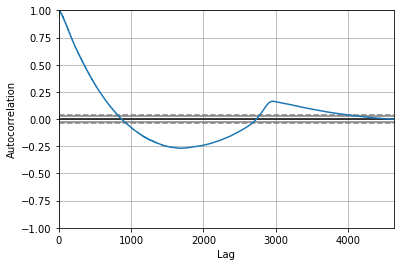

In [59]:
autocorrelation_plot(pd.DataFrame(LMGHP1S58J1004638_20181230[temperature_list]))

In [83]:
xyz_20181230.head(n=3)

,vin,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,temp_9,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
ts,,,,,,,,,,,,,,,,,,,,,
2018-12-30 00:00:05+08:00,LMGHP1S57J1002315,8.0,9.0,9.0,12.0,13.0,13.0,13.0,16.0,16.0,...,16.0,14.0,9.0,11.0,11.0,14.0,14.0,15.0,15.0,16.0
2018-12-30 00:00:05+08:00,LMWHP1S22J1000515,16.0,17.0,17.0,19.0,19.0,19.0,19.0,20.0,20.0,...,20.0,19.0,17.0,17.0,17.0,19.0,19.0,20.0,20.0,20.0
2018-12-30 00:00:05+08:00,LMGHP1S57H1001126,8.0,9.0,9.0,11.0,11.0,12.0,12.0,14.0,14.0,...,13.0,10.0,5.0,7.0,7.0,10.0,10.0,12.0,12.0,14.0


In [60]:
LMGHP1S51J1003086_20181230 = xyz_20181230[xyz_20181230.vin=='LMGHP1S51J1003086']

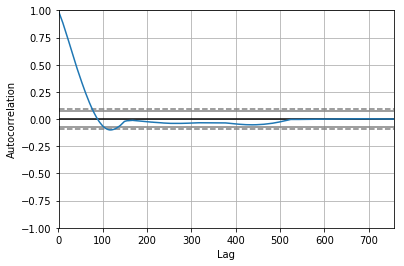

In [61]:
autocorrelation_plot(pd.DataFrame(LMGHP1S51J1003086_20181230[temperature_list]))

In [68]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [1]:
decomposition_LMGHP1S51J1003086_20181230 = seasonal_decompose(LMGHP1S51J1003086_20181230['temp_39'], freq=360)

NameError: name 'seasonal_decompose' is not defined

In [78]:
print(decomposition_LMGHP1S51J1003086_20181230)

In [82]:
trace1 = go.Scatter(
    x = decomposition_LMGHP1S51J1003086_20181230.Date, y = decomposition_LMGHP1S51J1003086_20181230.trend, name ='Trend', mode='line')
trace2 = go.Scatter(
    x = decomposition_LMGHP1S51J1003086_20181230.Date, y = decomposition_LMGHP1S51J1003086_20181230.seasonal, name ='Seasonal', mode='line')
trace3 = go.Scatter(
    x = decomposition_LMGHP1S51J1003086_20181230.Date, y = decomposition_LMGHP1S51J1003086_20181230.resid, name ='Residual', mode='line')
trace4 = go.Scatter(
    x = decomposition_LMGHP1S51J1003086_20181230.Date, y = decomposition_LMGHP1S51J1003086_20181230.mean, name ='Mean', mode='line')

data = [trace1, trace2, trace3, trace4]
plot(data)

AttributeError: 'DecomposeResult' object has no attribute 'Date'

# 20191120

In [64]:
import time
import sys

import findspark
findspark.init('/usr/hdp/current/spark2-client')

import pyspark
from pyspark.sql.functions import col

from sys import path
path.insert(0, '/home/prod/git/common/collect_raw_data_utils')
from data_collection import *
path.insert(0, '/home/prod/git/common/pyspark_utils')
from get_spark import get_spark
SPARK_CONFIG_LIST = [
    ('spark.app.name', 'get_raw_data'),           # spark job name
    ('spark.yarn.queue', 'prod'),                          # for production code, use 'prod', else use 'dev'
    ('spark.master', 'yarn'),                              # choose between 'yarn', 'local', or 'local[*]'
    ('spark.submit.deployMode', 'client'),                 # 'client' or 'cluster' mode
    ('spark.yarn.am.memory', '10g'),                       # memory for spark driver (application master), for client mode
    ('spark.executor.memory', '5g'),                       # memory for each executor
    ('spark.executor.cores', '5'),                         # max number of cores each executor can use (means number of tasks)
    ('spark.executor.instances', '5'),                    # max number of executors
]


spark = get_spark(SPARK_CONFIG_LIST)
sc = spark.sparkContext

hc = HiveContext(sc)

num_cells = 90
num_modules = 40
vintype = ['A5HEV']
sel_col = ['day', 'vin', 'ts']
sel_col += ["veh_charge_st", "veh_curr", "esd_sc_temp_list"]# "esd_sc_volt_list"]

In [66]:
def read_data(date_to_check): 
    stime = time.time()  
    raw_spark_df = get_raw_records_in_spark(hc, 
                                        vin_types=vintype,
                                       # vins=vins,
                                        record_times=date_to_check, 
                                        sel_cols=sel_col, 
                                        nrows_to_print=None)
    print("Get raw records in spark done!")
    raw_spark_df = raw_spark_df.repartition(1000, "vin")
    
    casted_columns = ['day', 'vin', col('ts').cast("long").alias('ts'), 'record_time',
                    col("veh_curr").cast("float").alias("veh_curr"),
                   #  col("veh_odo").cast("float").alias("veh_odo"),
                     col("veh_charge_st").cast("short").alias("veh_charge_st"),
                   #  col("veh_st").cast("int").alias("veh_st"),
                   "esd_sc_temp_list",# "esd_sc_volt_list", 
                   ]
    raw_spark_df = raw_spark_df.select(*casted_columns)
    raw_spark_df = convert_signal_str_to_col_use_spark(
        raw_spark_df,
        cols_split_dict={
            'esd_sc_temp_list':("temp", num_modules, "\|", "int"),
            #'esd_sc_volt_list':("volt", num_cells, "\|", "float")
        },
        other_cols=[c for c in raw_spark_df.columns if c not in ["esd_sc_temp_list"]]# "esd_sc_volt_list"]]
    )
    print("Split columns done!")
    
    raw_spark_df.drop(*["record_time"])
    print("drop column done!")
    
    print(raw_spark_df.show(5))

    vins = raw_spark_df.select("vin").distinct().collect()
    vins = [row.vin for row in vins]
    vin_sample = random.sample(list_of_vins, 100)
    num_vins = len(vin_sample)
    print("num of vins is " + str(num_vins))

    df_list = []
    num_vin_to_process = 10

    for ind in range(0, num_vins, num_vin_to_process):
        print("Process data from " + str(ind) + " to " + str(ind+num_vin_to_process))
        short_vin_list = vins[ind:(ind+num_vin_to_process)]
        slice_spark = raw_spark_df[raw_spark_df.vin.isin(short_vin_list)]
        vins_df = slice_spark.toPandas()

        # to reduce memory usage because of conversion from spark df to pandas df
        df_as_str = vins_df.to_csv(path_or_buf=None, index=False)
        del vins_df
        vins_df = pd.read_csv(StringIO(df_as_str), sep=",")
        del df_as_str
        df_list.append(vins_df)

    if len(df_list) > 0:
        raw_data_df = pd.concat(df_list)

    raw_spark_df.unpersist()
    del raw_spark_df
    
    #raw_spark_df.coalesce(1).write.format("com.databricks.spark.csv").option("header", "true").save("20191120.csv")
    print("Converting to Pandas done!")
    
    etime = time.time()
    print "Finished in {} seconds".format(etime - stime)
    
    return raw_data_df

In [68]:
from StringIO import StringIO
df_20191120 = read_data("20191120")

submitting query 
SELECT day, vin, ts, veh_charge_st, veh_curr, esd_sc_temp_list FROM 
guobiao_tsp_tbls.guobiao_raw_orc
WHERE vintype = 'A5HEV'
AND day = '20191120'
ORDER BY vin, ts
Get raw records in spark done!
Split columns done!
drop column done!
+--------+-----------------+----------+-------------------+--------+-------------+------+------+------+------+------+------+------+------+------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+
|     day|              vin|        ts|        record_time|veh_curr|veh_charge_st|temp_1|temp_2|temp_3|temp_4|temp_5|temp_6|temp_7|temp_8|temp_9|temp_10|temp_11|temp_12|temp_13|temp_14|temp_15|temp_16|temp_17|temp_18|temp_19|temp_20|temp_21|temp_22|temp_23|temp_24|temp_25|temp_26|temp_27|temp_28|temp_29|temp_30|temp_31|temp_32|temp_33|temp_34|temp_35|te

In [69]:
df_20191120.head(n=20)

,day,vin,ts,record_time,veh_curr,veh_charge_st,temp_1,temp_2,temp_3,temp_4,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,20191120,LMGHP1S5XJ1001935,1574183375,2019-11-20 01:09:35,-44.5,1,30,30,30,29,...,30,29,27,28,28,29,29,30,30,31
1,20191120,LMGHP1S5XJ1001935,1574183385,2019-11-20 01:09:45,-46.0,1,30,30,30,29,...,30,29,27,28,28,29,29,30,30,31
2,20191120,LMGHP1S5XJ1001935,1574183395,2019-11-20 01:09:55,-45.5,1,30,30,30,29,...,30,29,27,28,28,29,29,30,30,31
3,20191120,LMGHP1S5XJ1001935,1574183405,2019-11-20 01:10:05,-45.5,1,30,30,30,29,...,30,29,27,28,28,29,29,30,30,31
4,20191120,LMGHP1S5XJ1001935,1574183415,2019-11-20 01:10:15,-45.0,1,29,30,30,29,...,30,29,27,28,28,29,29,30,30,31
5,20191120,LMGHP1S5XJ1001935,1574183425,2019-11-20 01:10:25,-45.5,1,29,30,30,29,...,30,29,27,28,28,29,29,30,30,31
6,20191120,LMGHP1S5XJ1001935,1574183435,2019-11-20 01:10:35,-45.5,1,29,30,30,29,...,29,29,27,28,27,29,29,30,30,31
7,20191120,LMGHP1S5XJ1001935,1574183445,2019-11-20 01:10:45,-45.0,1,29,29,28,29,...,30,29,27,28,28,29,29,30,30,31
8,20191120,LMGHP1S5XJ1001935,1574183455,2019-11-20 01:10:55,-45.0,1,29,29,29,29,...,30,29,27,28,28,29,29,30,30,30
9,20191120,LMGHP1S5XJ1001935,1574183465,2019-11-20 01:11:05,-45.5,1,29,29,29,29,...,30,29,27,28,28,29,29,30,30,30


In [70]:
df_20191120.to_csv("df_20191120_sample100.csv")

In [72]:
df_20191120.columns

Index([u'day', u'vin', u'ts', u'record_time', u'veh_curr', u'veh_charge_st',
       u'temp_1', u'temp_2', u'temp_3', u'temp_4', u'temp_5', u'temp_6',
       u'temp_7', u'temp_8', u'temp_9', u'temp_10', u'temp_11', u'temp_12',
       u'temp_13', u'temp_14', u'temp_15', u'temp_16', u'temp_17', u'temp_18',
       u'temp_19', u'temp_20', u'temp_21', u'temp_22', u'temp_23', u'temp_24',
       u'temp_25', u'temp_26', u'temp_27', u'temp_28', u'temp_29', u'temp_30',
       u'temp_31', u'temp_32', u'temp_33', u'temp_34', u'temp_35', u'temp_36',
       u'temp_37', u'temp_38', u'temp_39', u'temp_40'],
      dtype='object')

In [73]:
all_temp_and_curr_20191120 = df_20191120.drop(['record_time'], axis=1)

In [75]:
fast_charging_mask = (all_temp_and_curr_20191120['veh_curr']) < -30 & (all_temp_and_curr_20191120['veh_charge_st'] == 1)
temp_20191120_fast_charging = all_temp_and_curr_20191120[fast_charging_mask]

In [117]:
charging_mask = (all_temp_and_curr_20191120['veh_curr']) < 0 & (all_temp_and_curr_20191120['veh_charge_st'] == 1)
temp_20191120_charging = all_temp_and_curr_20191120[charging_mask]

In [76]:
temp_20191120_fast_charging.head(n=1)

,day,vin,ts,veh_curr,veh_charge_st,temp_1,temp_2,temp_3,temp_4,temp_5,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,20191120,LMGHP1S5XJ1001935,1574183375,-44.5,1,30,30,30,29,29,...,30,29,27,28,28,29,29,30,30,31


In [77]:
temp_20191120_fast_charging = temp_20191120_fast_charging.drop(['veh_curr', 'veh_charge_st'], axis=1)
temp_20191120_fast_charging.to_csv("temp_20191120_fast_charging.csv")

# 采用的答案

In [91]:
import pandas as pd
temp_20191120_fast_charging = pd.read_csv("temp_20191120_fast_charging.csv", header=0, index_col=0)

In [118]:
temp_20191120_charging = temp_20191120_charging.drop(['veh_curr', 'veh_charge_st'], axis=1)
temp_20191120_charging.to_csv("temp_20191120_charging.csv")

In [92]:
temp_20191120_fast_charging.head(n=3)

,day,vin,ts,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,20191120,LMGHP1S5XJ1001935,1574183375,30,30,30,29,29,30,30,...,30,29,27,28,28,29,29,30,30,31
1,20191120,LMGHP1S5XJ1001935,1574183385,30,30,30,29,29,30,30,...,30,29,27,28,28,29,29,30,30,31
2,20191120,LMGHP1S5XJ1001935,1574183395,30,30,30,29,29,30,30,...,30,29,27,28,28,29,29,30,30,31


In [87]:
from datetime import datetime
from datetime import date, timedelta

In [96]:
#temp_20191120_fast_charging['ts'] = convert_ts_to_datetime(temp_20191120_fast_charging['ts'])
temp_20191120_fast_charging['ts'].describe()

count                         67755
unique                         8640
top       2019-11-20 00:35:35+08:00
freq                             18
Name: ts, dtype: object

In [97]:
temp_20191120_fast_charging['ts'].head()

0   2019-11-20 01:09:35+08:00
1   2019-11-20 01:09:45+08:00
2   2019-11-20 01:09:55+08:00
3   2019-11-20 01:10:05+08:00
4   2019-11-20 01:10:15+08:00
Name: ts, dtype: datetime64[ns, Asia/Hong_Kong]

In [88]:
temp_20191120_fast_charging['ts'] = pd.datetime(temp_20191120_fast_charging['ts']).dt.tz_convert('Asia/Hong_Kong')

TypeError: cannot convert the series to <type 'int'>

In [152]:
temp_20191120_charging['ts'] = convert_ts_to_datetime(temp_20191120_charging['ts'])

AttributeError: input ts is not in valid epoch time format

In [100]:
fast_charging_df_2 = temp_20191120_fast_charging

In [121]:
charging_df_2 = temp_20191120_charging

In [126]:
array_of_vins_2 = fast_charging_df_2.vin.unique()

In [209]:
array_of_vins_2_slow = charging_df_2.vin.unique()

In [127]:
list_of_vins_2 = array_of_vins_2.tolist()

In [210]:
list_of_vins_2_slow = array_of_vins_2_slow.tolist()

In [211]:
len(list_of_vins_2_slow)

95

In [212]:
list_of_vins_2.sort()
list_of_vins_2_slow.sort()

if list_of_vins_2 == list_of_vins_2_slow: 
    print ("The lists are identical") 
else : 
    print ("The lists are not identical") 

The lists are identical


In [216]:
from pandas.util.testing import assert_frame_equal
def get_different_rows(fast_charging_df_2, charging_df_2):
    try:
        assert_frame_equal(fast_charging_df_2, charging_df_2)
        return True
    except:  # appeantly AssertionError doesn't catch all
        return False
print(get_different_rows(fast_charging_df_2, charging_df_2))

True


In [101]:
print(fast_charging_df_2.head())

        day                vin                        ts  temp_1  temp_2  \
0  20191120  LMGHP1S5XJ1001935 2019-11-20 01:09:35+08:00      30      30   
1  20191120  LMGHP1S5XJ1001935 2019-11-20 01:09:45+08:00      30      30   
2  20191120  LMGHP1S5XJ1001935 2019-11-20 01:09:55+08:00      30      30   
3  20191120  LMGHP1S5XJ1001935 2019-11-20 01:10:05+08:00      30      30   
4  20191120  LMGHP1S5XJ1001935 2019-11-20 01:10:15+08:00      29      30   

   temp_3  temp_4  temp_5  temp_6  temp_7   ...     temp_31  temp_32  temp_33  \
0      30      29      29      30      30   ...          30       29       27   
1      30      29      29      30      30   ...          30       29       27   
2      30      29      29      30      30   ...          30       29       27   
3      30      29      29      30      30   ...          30       29       27   
4      30      29      29      30      30   ...          30       29       27   

   temp_34  temp_35  temp_36  temp_37  temp_38  temp_39 

In [116]:
#list_of_vins_2.remove('LMGHP1S56J1002385')

In [167]:
print(list_of_vins_2)

['LMGHP1S8XJ1003971', 'LMGHP1S8XH1S00102', 'LMGHP1S8XJ1001900', 'LMGHP1S59J1004678', 'LMGHP1S58H1000972', 'LMGHP1S59J1002459', 'LMWHP1S29J1000432', 'LMGHP1S58H1000342', 'LMGHP1S5XJ1003040', 'LMGHP1S53J1002425', 'LMWHP1S20J1000285', 'LMGHP1S54J1004152', 'LMGHP1S50J1004455', 'LMGHP1S53J1002439', 'LMGHP1S55J1004144', 'LMGHP1S51J1002438', 'LMWHP1S28J1000308', 'LMGHP1S59J1004227', 'LMGHP1S56J1004041', 'LMGHP1S57J1004016', 'LMGHP1S50J1002270', 'LMGHP1S5XJ1001935', 'LMGHP1S54H1001830', 'LMWHP1S28J1000180', 'LMGHP1S55J1003463', 'LMGHP1S51J1002570', 'LMGHP1S5XJ1004009', 'LMWHP1S24J1000435', 'LMGHP1S54H1000936', 'LMGHP1S55J1002717', 'LMGHP1S59J1003630', 'LMGHP1S53J1004482', 'LMGHP1S5XJ1003765', 'LMGHP1S89J1002651', 'LMGHP1S83H1001778', 'LMGHP1S52J1003341', 'LMGHP1S5XH1000648', 'LMGHP1S82H1000573', 'LMGHP1S57H1000803', 'LMGHP1S53J1003087', 'LMGHP1S59J1003661', 'LMGHP1S58H1000518', 'LMGHP1S83J1004380', 'LMGHP1S54J1004653', 'LMGHP1S50H1001100', 'LMGHP1S88H1001470', 'LMGHP1S50H1001114', 'LMGHP1S86H1

In [174]:
from collections import OrderedDict 
import itertools as it

dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
xyz = fast_charging_df_2
#xyz = charging_df_2
#xyz = xyz.reset_index()
#xyz = xyz.drop(xyz.columns[0], axis=1)
temperature_list = ["temp_" + str(s) for s in range(1,41)]

result_list_1 = []
result_list_2 = []
result_list_5 = []

#xyz['ts'] = pd.to_datetime(xyz['ts'])

#for vin in random.sample(list_of_vins, 100):
for vin in list_of_vins_2:
    print("Process " + vin + ":")
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)
    """
    ts_diff_2 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=12).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_2 = vin_df[temperature_list].mean(axis=1).diff(periods=12).iloc[1:]    
    rate_df_2 = temp_diff_2.div(ts_diff_2, axis=0)
    #rate_series_2 = pd.DataFrame(sorted(it.chain(*rate_df_2.values)))
    rate_series_2 = pd.DataFrame(rate_df_2.values)
    result_list_2.append(rate_series_2)
    """
    """
    ts_diff_1 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=6).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_1 = vin_df[temperature_list].mean(axis=1).diff(periods=6).iloc[1:]
    rate_df_1 = temp_diff_1.div(ts_diff_1, axis=0)
    #rate_series_1 = pd.DataFrame(sorted(it.chain(*rate_df_1.values)))    
    rate_series_1 = pd.DataFrame(rate_df_1.values)    
    result_list_1.append(rate_series_1)
    """
    ts_diff_5 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=30).iloc[1:].dt.seconds.div(60, fill_value=0)
    temp_diff_5 = vin_df[temperature_list].mean(axis=1).diff(periods=30).iloc[1:]
    rate_df_5 = temp_diff_5.div(ts_diff_5, axis=0)
    #rate_series_5 = pd.DataFrame(sorted(it.chain(*rate_df_5.values)))    
    rate_series_5 = pd.DataFrame(rate_df_5.values)   
    result_list_5.append(rate_series_5)
    """
    ts_diff_5 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=30).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_5 = vin_df[temperature_list].mean(axis=1).diff(periods=30).iloc[1:]
    rate_df_5 = temp_diff_5.div(ts_diff_5, axis=0)
    rate_df_5_subset = rate_df_5[rate_df_5 > 0.2]
    #print(type(rate_df_5))
    if len(rate_df_5_subset) != 0:
        suspect_vin.add(str(vin)+"_"+str(rate_df_5_subset.idxmax())+"_"+str(rate_df_5_subset.max())+"_"+str(temp_diff_5[rate_df_5_subset.idxmax()])
                       +"_"+str(ts_diff_5[rate_df_5_subset.idxmax()]))
    #rate_series_5 = pd.DataFrame(sorted(it.chain(*rate_df_5.values)))    
    #rate_series_5 = pd.DataFrame(rate_df_5.values)   
    result_list_5.append(rate_df_5_subset)
    """
    """
    ts_diff_1 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=30).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_1 = vin_df[temperature_list].mean(axis=1).diff(periods=30).iloc[1:]
    rate_df_1 = temp_diff_1.div(ts_diff_1, axis=0)
    rate_df_1_subset = rate_df_1[rate_df_1 > 0.2]
    if len(rate_df_1_subset) != 0:
        suspect_vin.add(str(vin)+"_"+str(rate_df_1_subset.idxmax()))
    #rate_series_1 = pd.DataFrame(sorted(it.chain(*rate_df_1.values)))    
    #rate_series_1 = pd.DataFrame(rate_df_1.values)   
    result_list_1.append(rate_df_1_subset)
    """
    print("Vin #" + str(i) + ":" + vin + ", the length of changing rate is " + str(len(result_list_5)))

Process LMGHP1S8XJ1003971:
Vin #1:LMGHP1S8XJ1003971, the length of changing rate is 1
Process LMGHP1S8XH1S00102:
Vin #2:LMGHP1S8XH1S00102, the length of changing rate is 2
Process LMGHP1S8XJ1001900:
Vin #3:LMGHP1S8XJ1001900, the length of changing rate is 3
Process LMGHP1S59J1004678:
Vin #4:LMGHP1S59J1004678, the length of changing rate is 4
Process LMGHP1S58H1000972:
Vin #5:LMGHP1S58H1000972, the length of changing rate is 5
Process LMGHP1S59J1002459:
Vin #6:LMGHP1S59J1002459, the length of changing rate is 6
Process LMWHP1S29J1000432:
Vin #7:LMWHP1S29J1000432, the length of changing rate is 7
Process LMGHP1S58H1000342:
Vin #8:LMGHP1S58H1000342, the length of changing rate is 8
Process LMGHP1S5XJ1003040:
Vin #9:LMGHP1S5XJ1003040, the length of changing rate is 9
Process LMGHP1S53J1002425:
Vin #10:LMGHP1S53J1002425, the length of changing rate is 10
Process LMWHP1S20J1000285:
Vin #11:LMWHP1S20J1000285, the length of changing rate is 11
Process LMGHP1S54J1004152:
Vin #12:LMGHP1S54J10041

In [175]:
#rate_1 = pd.concat(result_list_1, ignore_index=True)
#rate_2 = pd.concat(result_list_2, ignore_index=True)
rate_5 = pd.concat(result_list_5, ignore_index=True)

In [159]:
print(suspect_vin)

set(['LMGHP1S5XJ1001935_2019-11-20 17:11:25_0.019416666666666665_5.824999999999999_300.0', 'LMGHP1S50H1001100_2019-11-20 17:46:45_0.018416666666666668_5.525_300.0', 'LMGHP1S53J1002425_2019-11-20 16:19:25_0.017833333333333333_5.35_300.0', 'LMGHP1S8XH1S00102_2019-11-20 14:16:15_0.010694444444444444_3.8499999999999996_360.0', 'LMGHP1S56J1002385_2019-11-20 13:12:45_0.020166666666666663_6.049999999999999_300.0', 'LMGHP1S53J1002439_2019-11-20 16:36:15_0.014666666666666668_4.4_300.0', 'LMGHP1S55J1004435_2019-11-20 15:43:15_0.01325_3.9749999999999996_300.0', 'LMGHP1S52H1000823_2019-11-20 22:31:05_0.01425_4.275_300.0', 'LMGHP1S59J1002459_2019-11-20 17:43:45_0.015500000000000007_4.650000000000002_300.0', 'LMGHP1S55J1002717_2019-11-20 06:41:15_0.013666666666666666_4.1_300.0', 'LMGHP1S51J1002570_2019-11-20 11:14:55_0.02_6.0_300.0'])


In [131]:
print(suspect_vin)

set(['LMGHP1S56J1002385_2019-11-20 13:12:45_0.20166666666666663'])


In [133]:
print(suspect_vin)

set(['LMGHP1S50H1001100_2019-11-20 17:46:45_0.18416666666666667', 'LMGHP1S51J1002570_2019-11-20 11:14:55_0.2', 'LMGHP1S5XJ1001935_2019-11-20 17:11:25_0.19416666666666665', 'LMGHP1S56J1002385_2019-11-20 13:12:45_0.20166666666666663'])


In [144]:
print(suspect_vin)

set(['LMGHP1S51J1002570_2019-11-20 11:29:05_0.12152777777777778', 'LMGHP1S5XJ1001935_2019-11-20 00:59:05_0.10513888888888889', 'LMGHP1S56J1002385_2019-11-20 13:28:55_0.11597222222222223'])


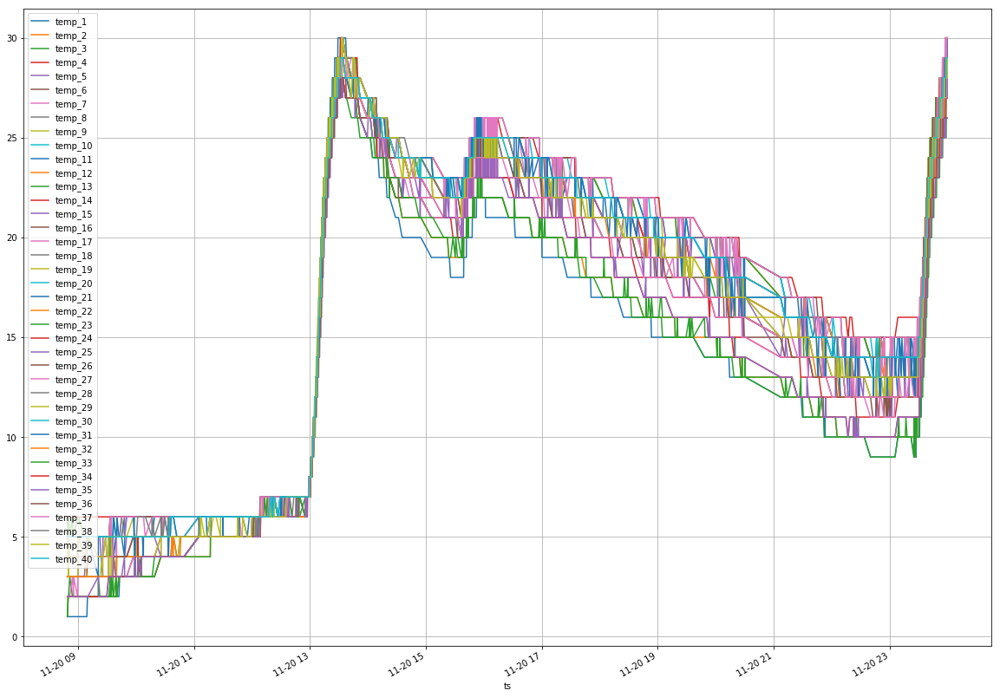

In [108]:
import matplotlib.pyplot as plt
temperature_list = ["temp_" + str(s) for s in range(1,41)]
fast_charging_df_2 = fast_charging_df_2.set_index('ts')
fast_charging_df_2[fast_charging_df_2.vin=='LMGHP1S56J1002385'][temperature_list].plot(figsize=(20, 15), grid=True)
plt.legend(loc='upper left')

In [147]:
fast_charging_df_2[fast_charging_df_2.vin=='LMGHP1S56J1002385'][temperature_list].iplot(mode = "lines+markers")

In [ ]:
temp_spark_df = sc.DataFrame(rate_5)

In [242]:
rate_1.isnull().sum()

0    475
dtype: int64

In [220]:
rate_2.isnull().sum()

0    1044
dtype: int64

In [176]:
rate_5.isnull().sum()

0    2706
dtype: int64

In [177]:
#rate_1.columns = ["rate"]
#rate_2.columns = ["rate"]
rate_5.columns = ["rate"]

In [178]:
#rate_1.to_csv("mean_rate_1_v2.csv")
#rate_2.to_csv("mean_rate_2_v2.csv")
#rate_5.to_csv("mean_rate_5_v2.csv")
rate_5.to_csv("mean_rate_5_v3_1min.csv")

In [192]:
rate_1 = pd.read_csv("fast_rate_1_v2.csv").drop(rate_1.columns[0], axis=1)

In [247]:
rate_1.head(n=2)

,rate
6,0.000431
7,0.003302


In [35]:
len(rate_1)
len(rate_2)
len(rate_5)

24000

In [203]:
import pandas as pd

In [179]:
#rate_1 = rate_1[rate_1.rate.notnull()].ix[rate_1['rate'] > 0]
#rate_2 = rate_2[rate_2.rate.notnull()].ix[rate_2['rate'] > 0]
rate_5 = rate_5[rate_5.rate.notnull()].ix[rate_5['rate'] > 0]

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning:


.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated



In [180]:
rate_5.describe()

,rate
count,33241.000000
mean,0.087207
std,0.175256
min,0.000030
25%,0.005960
50%,0.015000
75%,0.055000
max,1.210000


In [248]:
rate_1.describe()

,rate
count,26938.000000
mean,0.021808
std,0.033291
min,0.000021
25%,0.004167
50%,0.008333
75%,0.025000
max,0.258333


In [227]:
rate_2.describe()

,rate
count,29011.000000
mean,0.018106
std,0.031629
min,0.000005
25%,0.002083
50%,0.004167
75%,0.016667
max,0.227083


In [258]:
rate_5.describe()

,rate
count,33241.000000
mean,0.014535
std,0.029209
min,0.000005
25%,0.000993
50%,0.002500
75%,0.009167
max,0.201667


In [249]:
rate_1.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.095833
0.98,0.141667
0.99,0.166667


In [228]:
rate_2.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.081250
0.98,0.133333
0.99,0.162500


In [259]:
rate_5.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.067500
0.98,0.125833
0.99,0.150500


In [181]:
rate_5.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.405
0.98,0.755
0.99,0.903


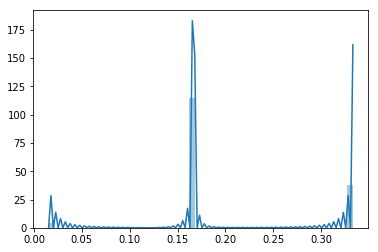

In [56]:
import seaborn as sns
ax = sns.distplot(rate_2)

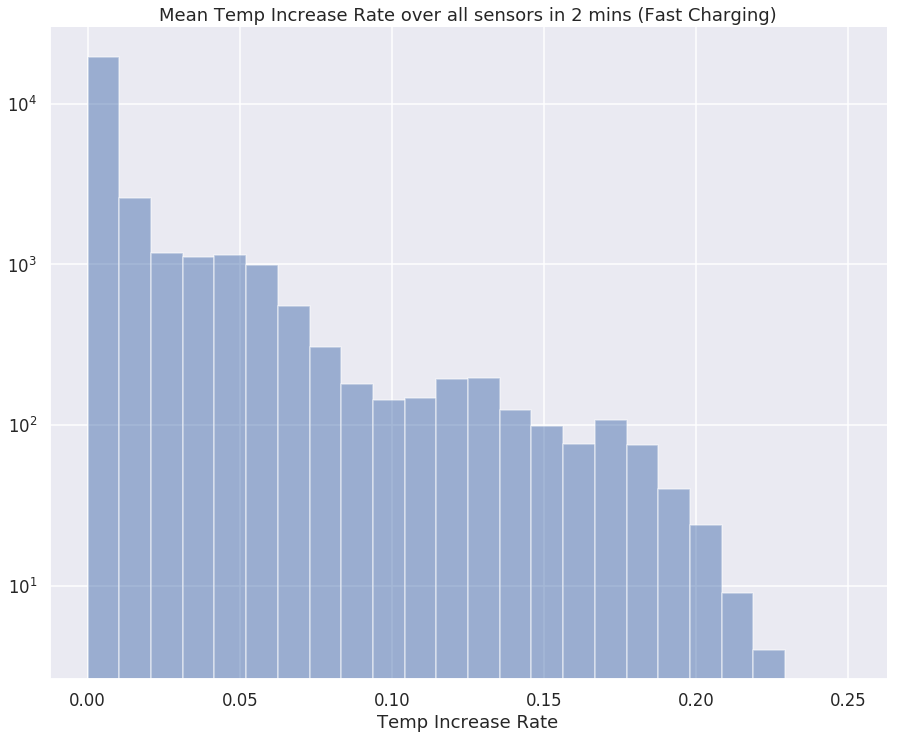

In [229]:
import numpy as np
import matplotlib.pyplot as plt
bins = np.linspace(0, 0.25, 25)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_2['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Mean Temp Increase Rate over all sensors in 2 mins (Fast Charging)')
sns.despine()

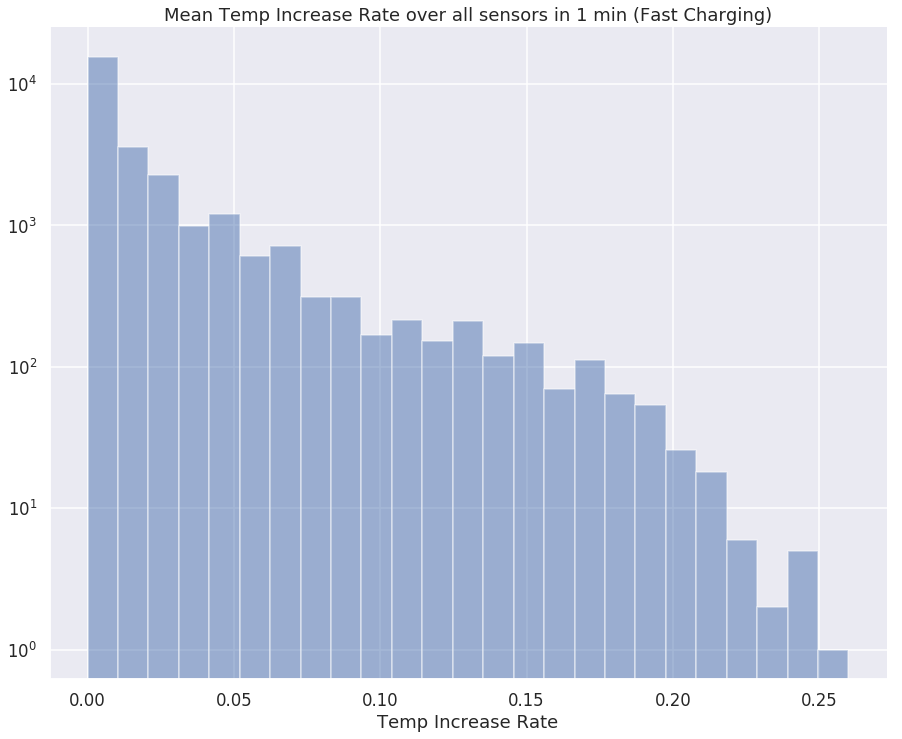

In [251]:
import numpy as np
import matplotlib.pyplot as plt
bins = np.linspace(0, 0.26, 26)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_1['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Mean Temp Increase Rate over all sensors in 1 min (Fast Charging)')
sns.despine()

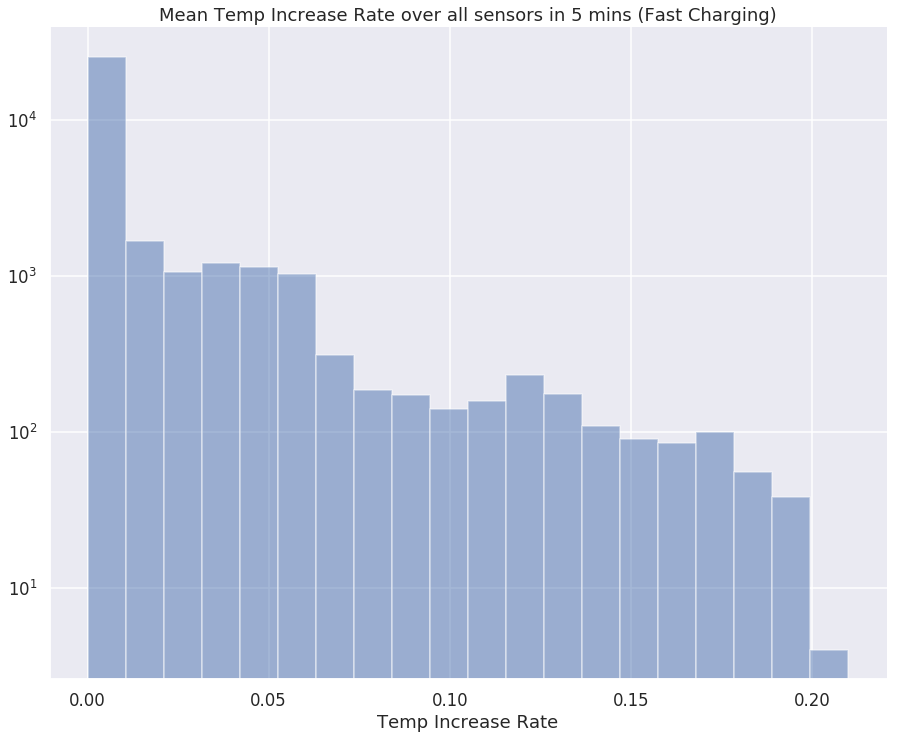

In [261]:
import numpy as np
import matplotlib.pyplot as plt
bins = np.linspace(0, 0.21, 21)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_5['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Mean Temp Increase Rate over all sensors in 5 mins (Fast Charging)')
sns.despine()

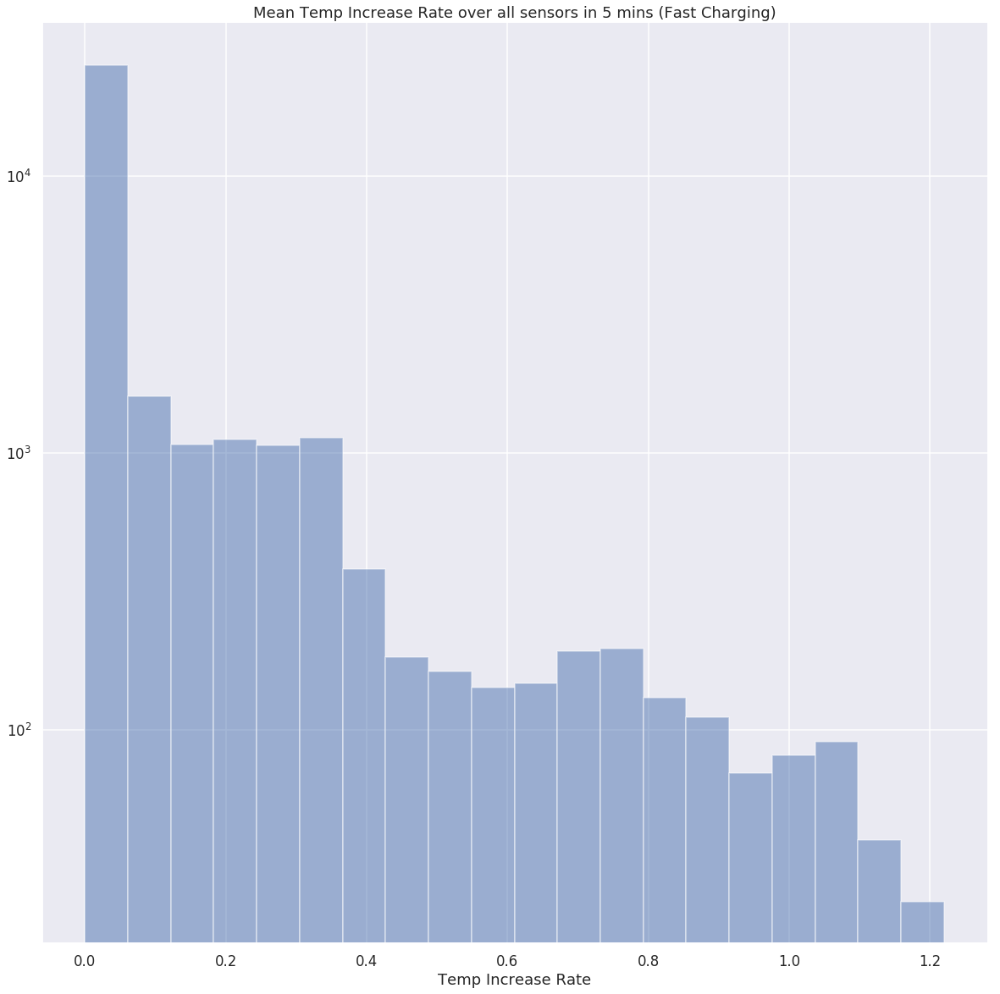

In [184]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(rc={"figure.figsize": (20, 20)})
sns.set_context('talk')
bins = np.linspace(0, 1.22, 21)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_5['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Mean Temp Increase Rate over all sensors in 5 mins (Fast Charging)')
sns.despine()

# 结束

# fast Charging

In [15]:
all_temp_and_curr_20181230 = frame_all_20181230.drop(voltage_list, axis=1)

In [ ]:
all_temp_and_curr_20181230.head(n=3)

In [18]:
all_temp_and_curr_20181230.to_csv("all_temp_and_curr_20181230.csv")

In [2]:
import pandas as pd
all_temp_and_curr_20181230 = pd.read_csv("all_temp_and_curr_20181230.csv", index_col=None)

In [23]:
all_temp_and_curr_20181230 = all_temp_and_curr_20181230.drop(all_temp_and_curr_20181230.columns[0], axis=1)

In [25]:
fast_charging_mask = all_temp_and_curr_20181230['veh_curr'] < -30
temp_20181230_fast_charging = all_temp_and_curr_20181230[fast_charging_mask]

In [28]:
temp_20181230_fast_charging = temp_20181230_fast_charging.drop(['veh_curr'], axis=1)
temp_20181230_fast_charging.to_csv("temp_20181230_fast_charging.csv")

,vin,ts,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
1,LMWHP1S22J1000515,2018-12-30 08:00:05,16.0,17.0,17.0,19.0,19.0,19.0,19.0,20.0,...,20.0,19.0,17.0,17.0,17.0,19.0,19.0,20.0,20.0,20.0
5,LMWHP1S26J1000114,2018-12-30 08:00:05,17.0,18.0,18.0,20.0,20.0,21.0,21.0,22.0,...,22.0,20.0,18.0,19.0,19.0,21.0,21.0,21.0,21.0,22.0
6,LMGHP1S54J1003079,2018-12-30 08:00:05,13.0,14.0,15.0,16.0,17.0,18.0,18.0,20.0,...,19.0,17.0,13.0,14.0,14.0,17.0,18.0,18.0,18.0,20.0


In [12]:
import pandas as pd
temp_20181230_fast_charging = pd.read_csv("temp_20181230_fast_charging.csv")

In [14]:
temp_20181230_fast_charging = temp_20181230_fast_charging.drop(temp_20181230_fast_charging.columns[0], axis=1)

In [15]:
temp_20181230_fast_charging.head(n=3)

,vin,ts,temp_1,temp_2,temp_3,temp_4,temp_5,temp_6,temp_7,temp_8,...,temp_31,temp_32,temp_33,temp_34,temp_35,temp_36,temp_37,temp_38,temp_39,temp_40
0,LMWHP1S22J1000515,2018-12-30 08:00:05,16.0,17.0,17.0,19.0,19.0,19.0,19.0,20.0,...,20.0,19.0,17.0,17.0,17.0,19.0,19.0,20.0,20.0,20.0
1,LMWHP1S26J1000114,2018-12-30 08:00:05,17.0,18.0,18.0,20.0,20.0,21.0,21.0,22.0,...,22.0,20.0,18.0,19.0,19.0,21.0,21.0,21.0,21.0,22.0
2,LMGHP1S54J1003079,2018-12-30 08:00:05,13.0,14.0,15.0,16.0,17.0,18.0,18.0,20.0,...,19.0,17.0,13.0,14.0,14.0,17.0,18.0,18.0,18.0,20.0


In [16]:
fast_charging_df = temp_20181230_fast_charging

In [17]:
array_of_vins = fast_charging_df.vin.unique()

In [18]:
list_of_vins = array_of_vins.tolist()

In [19]:
len(list_of_vins)

2551

In [20]:
xyz.head(n=5)

NameError: name 'xyz' is not defined

In [113]:
from collections import OrderedDict 
import itertools as it

dic = OrderedDict() 
i = 0
rate_list = []       # get all the rates for histogram
suspect_vin = set()
rate_to_check = 6
anomaly_to_check = 2

import random
xyz = fast_charging_df
#xyz = xyz.reset_index()
#xyz = xyz.drop(xyz.columns[0], axis=1)
temperature_list = ["temp_" + str(s) for s in range(1,41)]

result_list_1 = []
result_list_2 = []
result_list_5 = []

xyz['ts'] = pd.to_datetime(xyz['ts'])

for vin in random.sample(list_of_vins, 100):
    vindf = xyz[xyz.vin == vin]

    vin_df = vindf.reset_index()

    i = i + 1

    vin_df['ts'] = vin_df['ts'].dt.tz_localize(None)
    vin_df = vin_df.sort_values(by='ts')

    vin_df = vin_df.set_index(["ts"], inplace = False)
    """
    ts_diff_2 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=12).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_2 = vin_df[temperature_list].diff(periods=12).iloc[1:]    
    rate_df_2 = temp_diff_2.div(ts_diff_2, axis=0)
    rate_series_2 = pd.DataFrame(sorted(it.chain(*rate_df_2.values)))
    result_list_2.append(rate_series_2)
    """
    """
    ts_diff_1 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=6).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_1 = vin_df[temperature_list].diff(periods=6).iloc[1:]
    rate_df_1 = temp_diff_1.div(ts_diff_1, axis=0)
    rate_series_1 = pd.DataFrame(sorted(it.chain(*rate_df_1.values)))    
    result_list_1.append(rate_series_1)
    """
    #"""
    ts_diff_5 = pd.Series(vin_df.index, index=vin_df.index).diff(periods=30).iloc[1:].dt.seconds.div(10, fill_value=0)
    temp_diff_5 = vin_df[temperature_list].diff(periods=30).iloc[1:]
    rate_df_5 = temp_diff_5.div(ts_diff_5, axis=0)
    rate_series_5 = pd.DataFrame(sorted(it.chain(*rate_df_5.values)))    
    result_list_5.append(rate_series_5)
    #"""
    print("Vin #" + str(i) + ":" + vin + ", the length of changing rate is " + str(len(result_list_5)))

Vin #1:LMGHP1S50H1001419, the length of changing rate is 1
Vin #2:LMWHP1S29J1000530, the length of changing rate is 2
Vin #3:LMGHP1S55H1000766, the length of changing rate is 3
Vin #4:LMWHP1S28J1000177, the length of changing rate is 4
Vin #5:LMGHP1S52J1004134, the length of changing rate is 5
Vin #6:LMGHP1S57J1002377, the length of changing rate is 6
Vin #7:LMGHP1S58J1003795, the length of changing rate is 7
Vin #8:LMWHP1S25J1000458, the length of changing rate is 8
Vin #9:LMGHP1S56H1001263, the length of changing rate is 9
Vin #10:LMGHP1S56J1003925, the length of changing rate is 10
Vin #11:LMWHP1S21J1000389, the length of changing rate is 11
Vin #12:LMGHP1S55H1000914, the length of changing rate is 12
Vin #13:LMGHP1S5XJ1002941, the length of changing rate is 13
Vin #14:LMGHP1S56J1002984, the length of changing rate is 14
Vin #15:LMGHP1S51H1000523, the length of changing rate is 15
Vin #16:LMGHP1S85J1003876, the length of changing rate is 16
Vin #17:LMWHP1S23J1000281, the length of c

In [114]:
#rate_1 = pd.concat(result_list_1, ignore_index=True)
#rate_2 = pd.concat(result_list_2, ignore_index=True)
rate_5 = pd.concat(result_list_5, ignore_index=True)

In [26]:
#rate_2.to_csv("fast_charging_rate_2.csv")
rate_1.to_csv("fast_charging_rate_1.csv")

In [27]:
rate_1.isnull().sum()

0    16160
dtype: int64

In [43]:
rate_2.isnull().sum()

0    31280
dtype: int64

In [35]:
rate_5.isnull().sum()

0    66520
dtype: int64

In [115]:
#rate_1.columns = ["rate"]
#rate_2.columns = ["rate"]
rate_5.columns = ["rate"]

In [116]:
#rate_1.to_csv("fast_rate_1.csv")
#rate_2.to_csv("fast_rate_2.csv")
rate_5.to_csv("fast_rate_5.csv")

In [35]:
len(rate_1)
len(rate_2)
len(rate_5)

24000

In [11]:
import pandas as pd

In [46]:
#rate_1 = rate_1[rate_1.rate.notnull()].ix[rate_1['rate'] > 0]
rate_2 = rate_2[rate_2.rate.notnull()].ix[rate_2['rate'] > 0]
#rate_5 = rate_5[rate_5.rate.notnull()].ix[rate_5['rate'] > 0]

/usr/lib/python2.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  


In [31]:
rate_1.describe()

,rate
count,169732.000000
mean,0.161283
std,0.068381
min,0.000178
25%,0.166667
50%,0.166667
75%,0.166667
max,1.333333


In [47]:
rate_2.describe()

,rate
count,367439.000000
mean,0.087038
std,0.041473
min,0.000251
25%,0.083333
50%,0.083333
75%,0.083333
max,1.000000


In [72]:
rate_1.describe()

NameError: name 'rate_1' is not defined

In [39]:
rate_5.describe()

,rate
count,553374.000000
mean,0.049027
std,0.036487
min,0.000127
25%,0.033333
50%,0.033333
75%,0.066667
max,0.375000


In [32]:
rate_1.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.166667
0.98,0.333333
0.99,0.333333


In [48]:
rate_2.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.166667
0.98,0.166667
0.99,0.230769


In [40]:
rate_5.quantile([.95, .98, .99], axis = 0)

,rate
0.95,0.133333
0.98,0.166667
0.99,0.166667


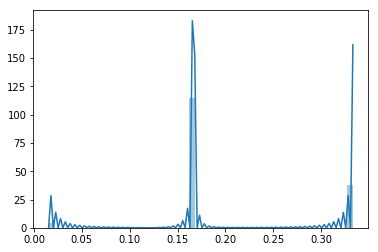

In [56]:
import seaborn as sns
ax = sns.distplot(rate_2)

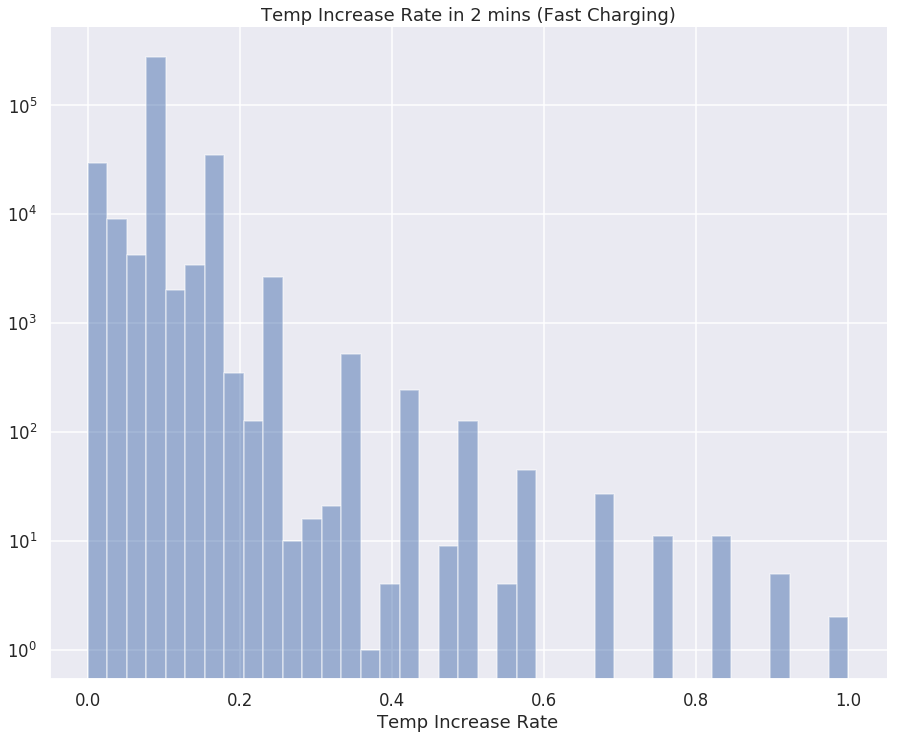

In [58]:
import numpy as np
import matplotlib.pyplot as plt
bins = np.linspace(0, 1, 40)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_2['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Temp Increase Rate in 2 mins (Fast Charging)')
sns.despine()

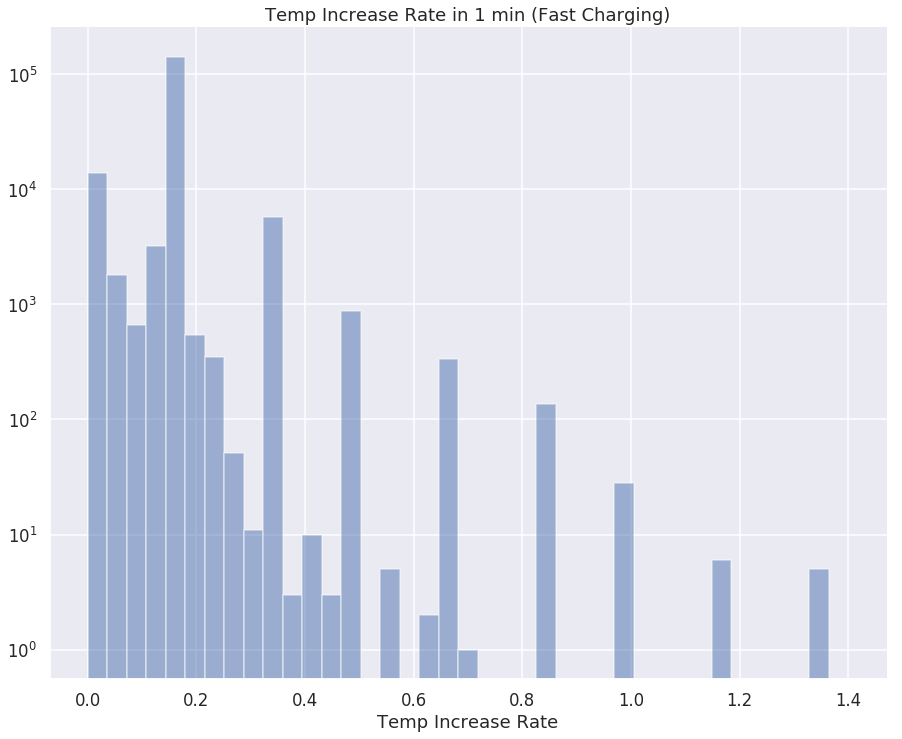

In [61]:
import numpy as np
import matplotlib.pyplot as plt
bins = np.linspace(0, 1.4, 40)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_1['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Temp Increase Rate in 1 min (Fast Charging)')
sns.despine()

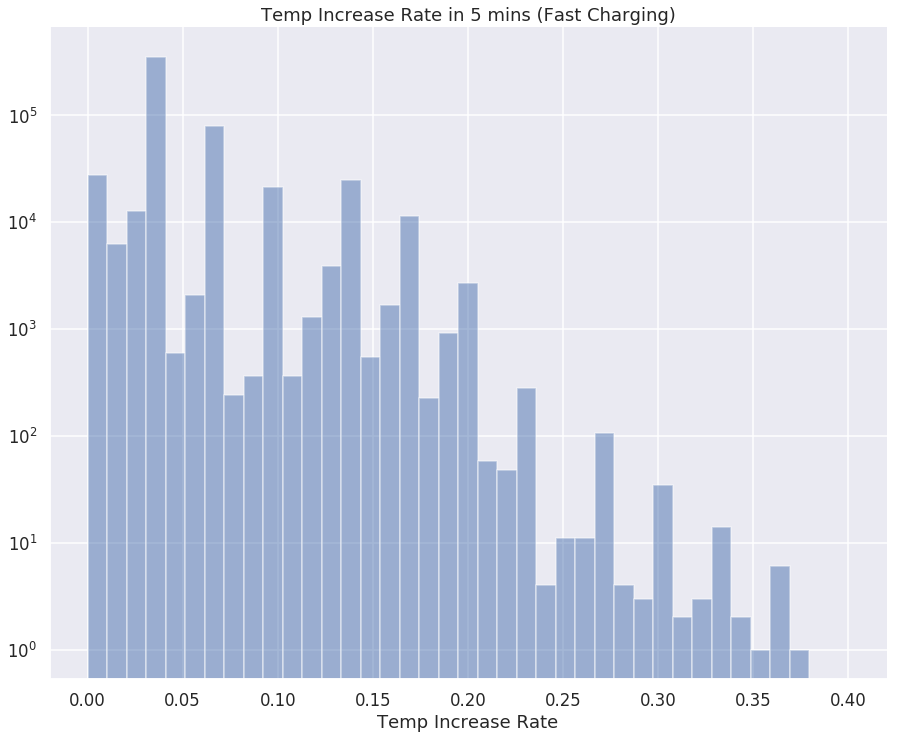

In [62]:
import numpy as np
import matplotlib.pyplot as plt
bins = np.linspace(0, 0.4, 40)

fig, axs = plt.subplots()
#axs.text(5, 1.01, title, ha='center') # fontsize=16)
axs.hist(rate_5['rate'], label = 'Changing Rate', bins=bins, alpha=0.5)

plt.yscale('log')
axs.set_xlabel('Temp Increase Rate')
axs.set_title('Temp Increase Rate in 5 mins (Fast Charging)')
sns.despine()